# Adversarial Search

CSI 4106 - Fall 2024

Marcel Turcotte  
Version: Nov 25, 2024 08:09

# Preamble

## Quote of the Day

<https://youtu.be/RV_SdCfZ-0s>

## Adversarial Search

This lecture examines **competitive environments** where multiple agents
have conflicting objectives, resulting in **adversarial search
problems**.

## Learning objectives

-   **Explain** zero-sum game concepts
-   **Formulate** never-lose strategies in Tic-Tac-Toe regardless of
    opponent moves
-   **Utilize** the **minimax** algorithm to determine optimal moves in
    adversarial settings
-   **Articulate** how **alpha-beta pruning** reduces the number of
    nodes evaluated without affecting outcomes

## Search

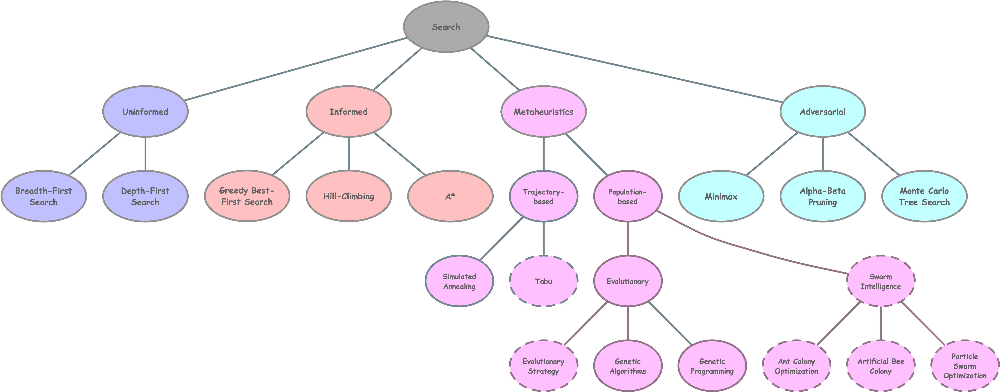

# Introduction

## Types of Games

-   **Deterministic** or **stochastic**. stochastic game: minesweeper, any card game, any game with dice
-   **One**, **two**, or **more** players
-   **Zero-sum** or not
-   **Perfect information** or not

## Definition

**Zero-sum games** are competitive scenarios where one player’s **gain**
is exactly balanced by another player’s **loss**, **resulting in a net
change of zero** in total wealth or benefit.

**Tic-tac-toe** is a zero-sum game.

## Deterministic Games

-   **States**: $S$ ($S_0$ to $S_k$)
-   **Players**: $P = {1, N}$
-   **Actions**: $A$ (depends on $P$ and $S$)
-   **Transition function**: $S \times A \rightarrow S$
-   **A final state**: $S_\mathrm{final}$
-   **Reward or utility**: $S_\mathrm{final}, p$

Develop a policy $S_0 \rightarrow S_\mathrm{final}$.

## What do think?

-   Consider playing **tic-tac-toe**.
-   Can you ensure **a never-lose strategy**, irrespective of your
    opponent’s moves?
-   Extend this analysis to games like **chess** or **Go**.

Does it matter if you play first or second?

Anyone who has played tic-tac-toe understands that the first player can
adopt a strategy that ensures they never lose.

In itself this statement is rather surprising. Why?

**How many board configurations are there?**

-   Each square can be occupied by X or O or be empty. This leads to
    $3^9= 19,683$ board configurations.
-   Are all these configurations possible in a valid game?

**Game progression.**

-   Not all of these configurations are valid game states because they
    may contain impossible numbers of Xs and Os or may not follow the
    rules of the game.

-   A tic-tac-toe game can end in a win for either player or a draw. The
    longest game without a winner involves 9 moves (a full board).

-   Valid games account for the rules that players alternate turns,
    starting with X.

-   How many valid sequences of moves are there?

## Tic-Tac-Toe

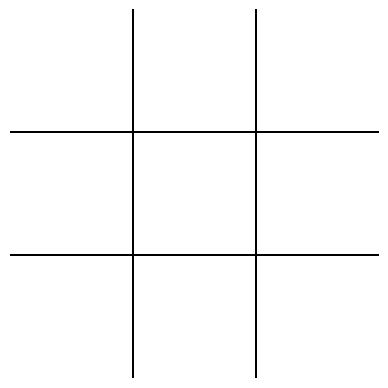

Let’s represent the state of a **tic-tac-toe game** with a **numpy
array**:

``` python
current_state = np.full((3, 3), ' ')
```

## `get_valid_moves`

In [5]:
def get_valid_moves(state):

    size = state.shape[0]

    # Returns a list of available positions
    moves = []
    for i in range(size):
        for j in range(size):
            if state[i][j] == ' ':
                moves.append((i, j))

    return moves

## `make_move`

In [6]:
def make_move(state, move, player):

    # Returns a new state after making the move
    new_state = state.copy()
    new_state[move] = player

    return new_state

## `is_terminal`

In [7]:
def is_terminal(state):

    # Check rows, columns, and diagonals for a win
    lines = []
    lines.extend(state)  # Rows
    lines.extend(state.T)  # Columns
    lines.append(np.diagonal(state))  # Main diagonal
    lines.append(np.diagonal(np.fliplr(state)))  # Anti-diagonal

    for line in lines:
        if np.all(line == 'X') or np.all(line == 'O'):
            return True

    # Check for a draw (no empty spaces)
    if ' ' not in state:
        return True

    return False

## `get_opponent`

In [8]:
def get_opponent(player):
    return 'O' if player == 'X' else 'X'

## `count_valid_sequences`

In [9]:
def count_valid_sequences(state, player):

    if is_terminal(state):
      return 1

    valid_moves = get_valid_moves(state)

    total = 0
    for move in valid_moves:
        new_state = make_move(state, move, player)
        total += count_valid_sequences(new_state, get_opponent(player))

    return total

The total number of valid sequences is: 255,168

Considering the number of valid sequences, it is unsurprising that the
first player can adopt a strategy to avoid losing?

## Symmetry (digression)

. . .

Tic-tac-toe has **8 symmetrical transformations** (4 rotations and 4
reflections).

By considering these, many game sequences that are different in raw move
order become equivalent.

The number of **unique sequences of moves** is **26,830**, whereas the
number of unique board positions is **765**.

**Exercise**: write a Python program the confirm the above.

## Search Tree

The **search tree size** for the tic-tac-toe game is **relatively
small**, making it suitable for use as a running example in later
discussions.

How does this compare to the search trees for chess and Go?

## Search Tree

-   **Chess**: $35^{80} \sim 10^{123}$

-   **Go**: $361! \sim 10^{768}$

The estimated **number of atoms in the observable universe** is around
$10^{78}$ to $10^{82}$.

**Chess**:

Chess has a relatively small board ($8 \times 8$) but a variety of
pieces with different movement capabilities.

On average, each position has about 35 legal moves.

Considering an average game length of 80 ply (a ply is a half-move, so
40 moves per player), the total games are estimated using the formula:
$35^{80} \sim 10^{123}$, adjusted down to account for illegal and
redundant positions.

**Go**:

Go is played on a $19 \times 19$ board, providing 361 points where
stones can be placed. Accordingly, the total number of games is
$361! \sim 10^{768}$.

## Definition

**Optimal play** involves executing the **best possible move at each
step** to maximize winning chances or outcomes.

In **perfect information games** like tic-tac-toe or chess, it requires
anticipating the opponent’s moves and choosing actions that enhance
one’s position or minimize losses.

When **both players employ optimal strategies**, the outcome—win, loss,
or draw—is dictated by the game’s inherent mechanics and initial
conditions.

Perfect information refers to a feature of certain games or
decision-making scenarios where all players have complete and accurate
knowledge of the entire game state at all times. This includes full
visibility of all actions taken previously and no hidden elements or
randomness affecting the game’s progression. In games with perfect
information, such as chess or tic-tac-toe, players can make fully
informed decisions based on the entire history and current status of the
game, allowing for strategies that can be planned several moves ahead.

## Two-Move Game

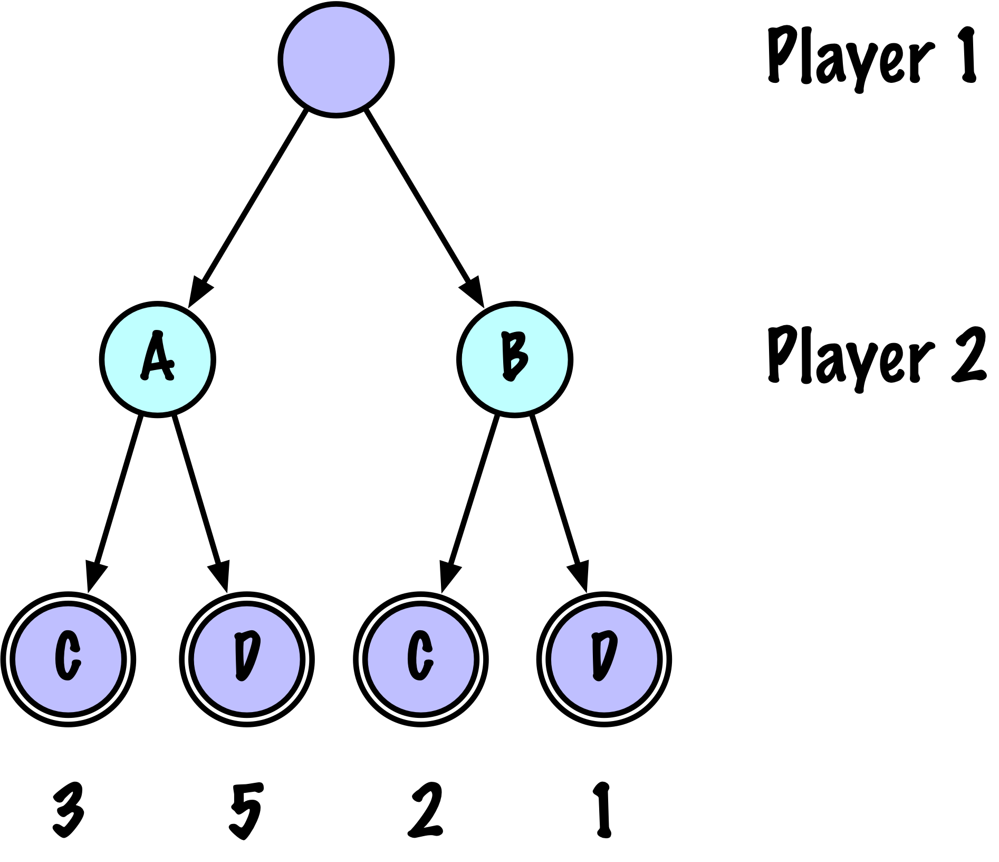

Two-Move is a hypothetical game involving two players, designed to
facilitate discussions on the minimax algorithm.

## Game Setup

-   The **game starts** with a single decision point for Player 1, who
    has two possible moves: $A$ and $B$.
-   Each of these moves leads to a **decision point for Player 2**, who
    also has two possible responses: $C$ and $D$.
-   The **game ends** after Player 2’s move, resulting in a terminal
    state with predefined scores.

## Search Tree

-   **Root Node**: Represents the initial state before Player 1’s move.
-   **Ply 1**: Player 1 chooses between moves $A$ and $B$.
-   **Ply 2**: For each of Player 1’s moves, Player 2 chooses between
    moves $C$ and $D$.
-   **Leaf Nodes**: Each branch’s endpoint is a terminal state with an
    associated score.

## Scores

-   $(A, C)$ results in a score of 3.
-   $(A, D)$ results in a score of 5.
-   $(B, C)$ results in a score of 2.
-   $(B, D)$ results in a score of 1.

**Player 1** wants to maximize its score.

## Strategy

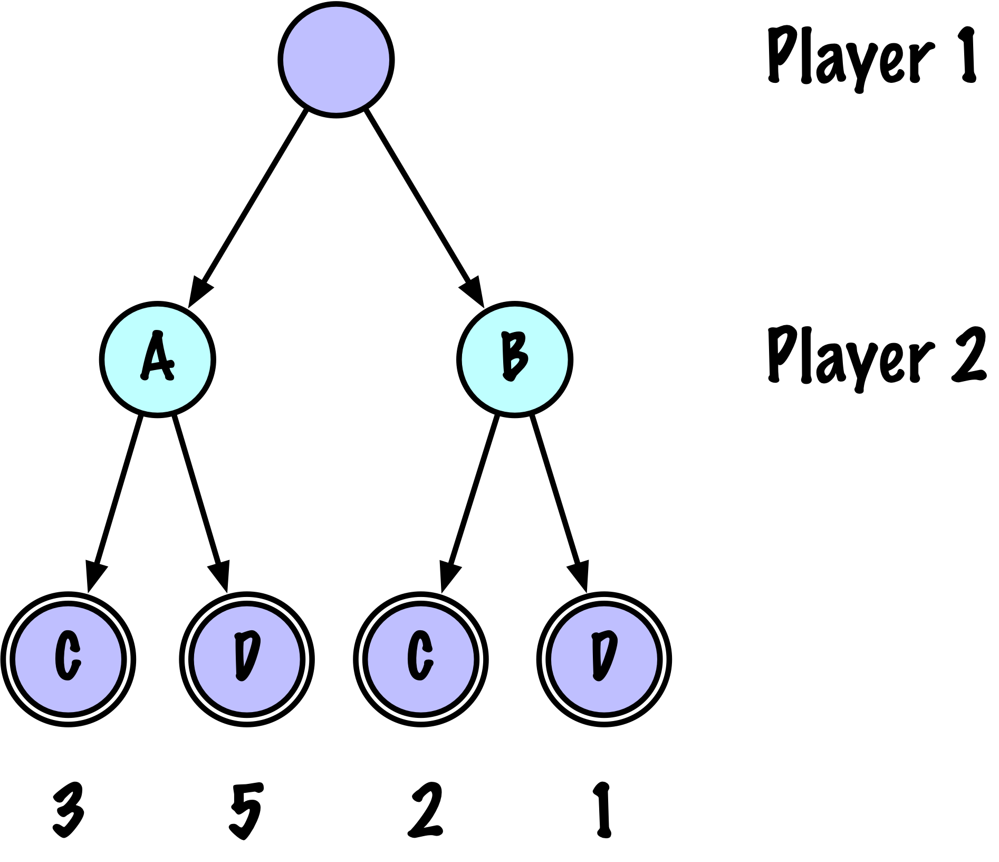

What should be **player 2’s strategy** and **why**?

## Strategy

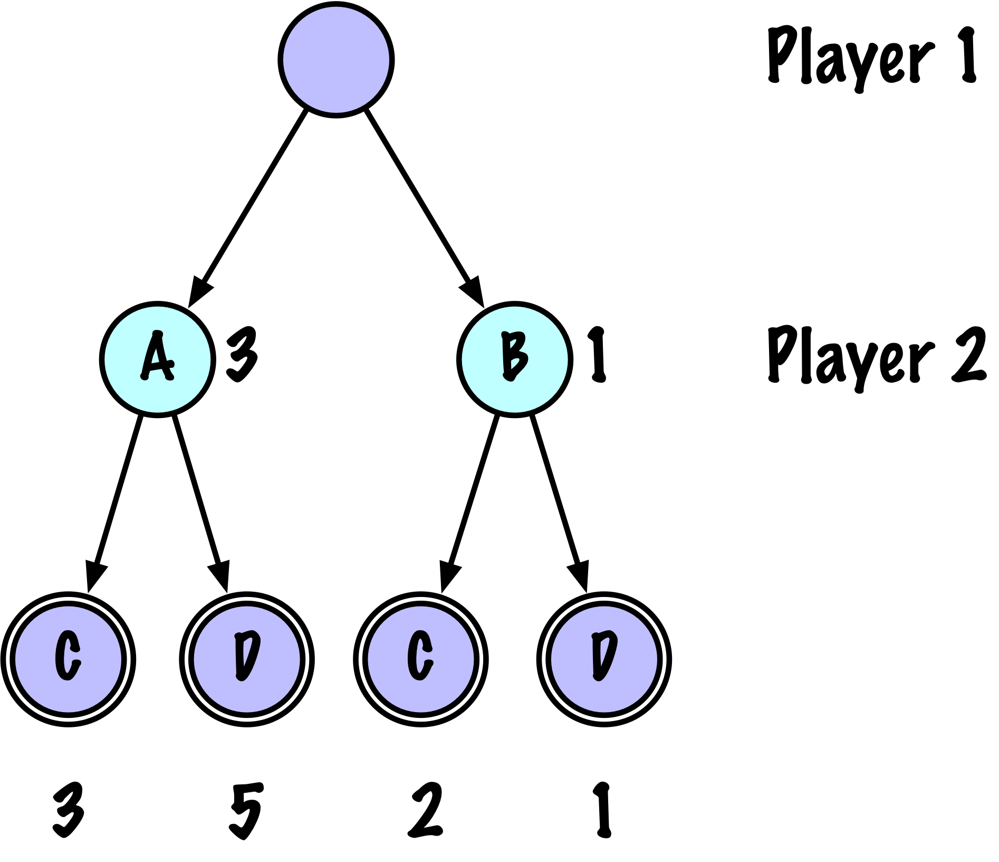

-   **For move $A$**:

    -   Player 2 can choose $C$ (score = 3) or $D$ (score = 5); they
        choose $C$ (minimizing to 3).

-   **For move $B$**:

    -   Player 2 can choose $C$ (score = 2) or $D$ (score = 1); they
        choose $D$ (minimizing to 1).

## Strategy

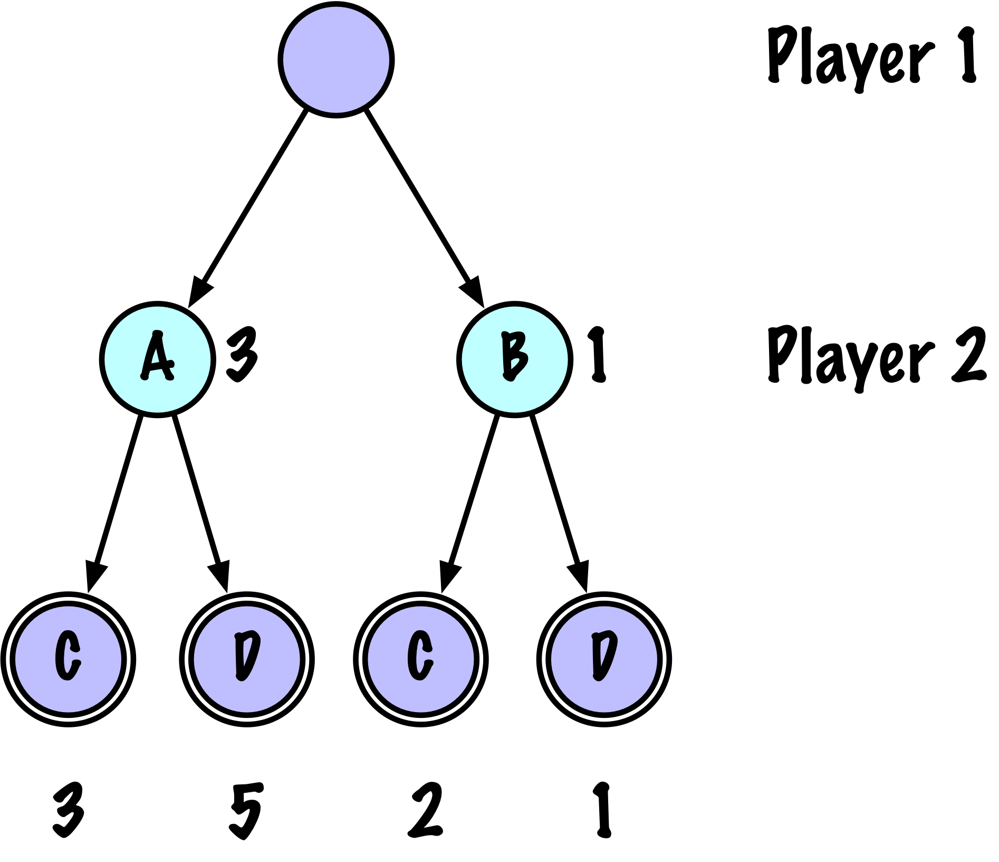

What should now be the strategy for **Player 1**?

## Strategy

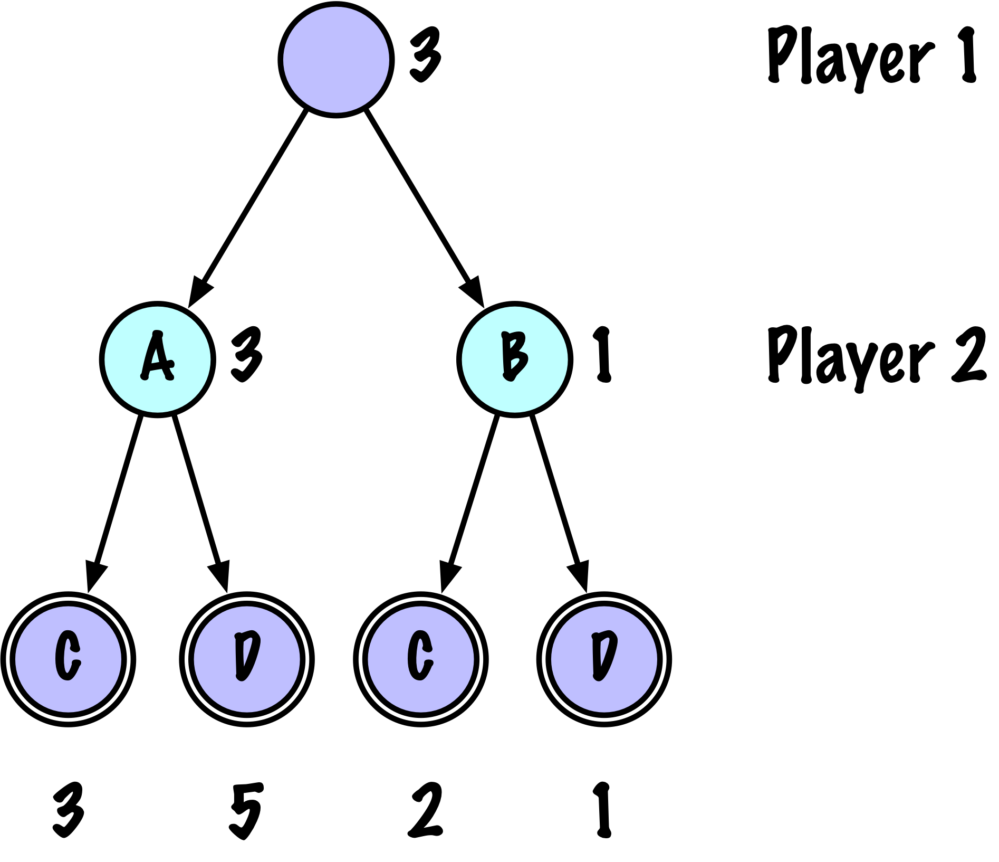

Player 1, being the **maximizer**, will choose move $A$, as it leads to
the higher score of 3 after Player 2 minimizes.

## Minimax

-   **Player 1** is the maximizing player, seeking the highest score.

-   **Player 2** is the minimizing player, seeking the lowest score.

**Evaluation**:

-   Player 2 evaluates the potential outcomes for each of their moves
    and chooses the **least favorable outcome** for Player 1.

-   Player 1 then evaluates these outcomes, choosing the move that
    **maximizes their minimum guaranteed score**.

## Minimax Search

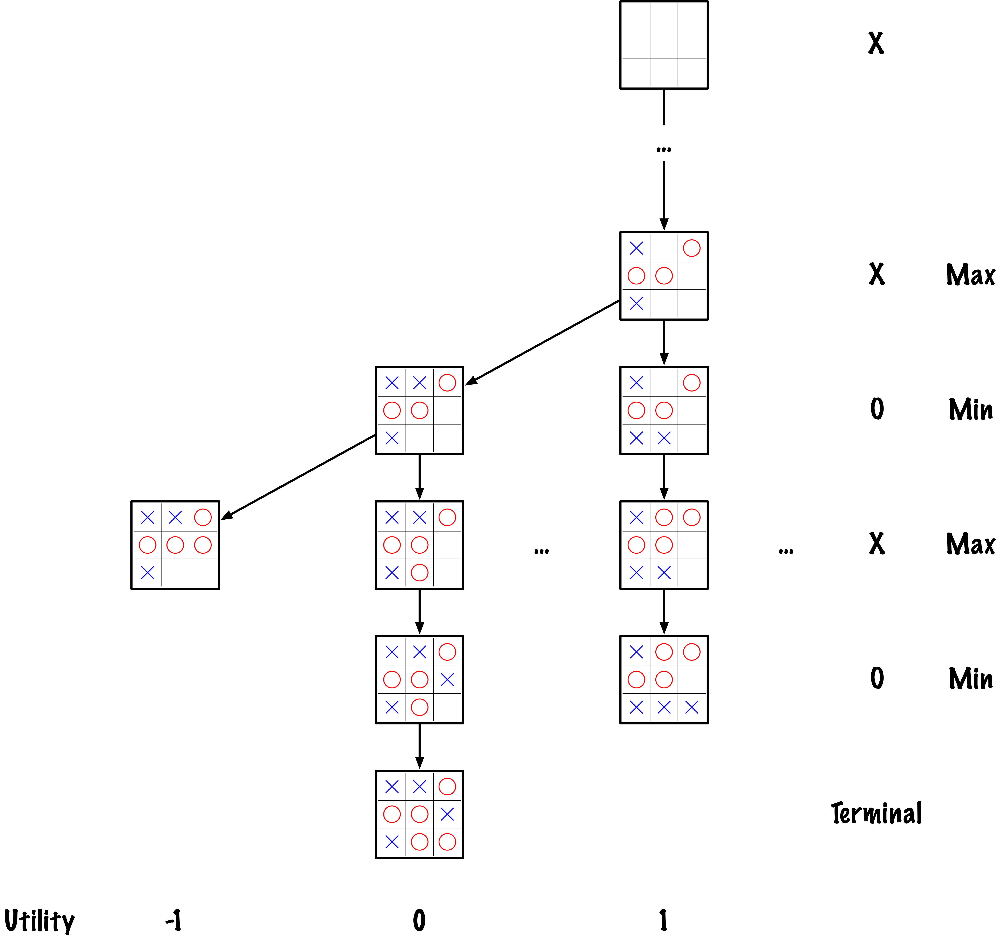

## Minimax Search

The **minimax algorithm** operates by exploring **all possible moves in
a game tree**, evaluating the outcomes to minimize the possible loss for
a worst-case scenario. At each node:

-   **Maximizing Player’s Turn:** Choose the move with the highest
    possible value.
-   **Minimizing Player’s Turn:** Choose the move with the lowest
    possible value.

By backtracking from the terminal nodes to the root, the algorithm
selects the move that **maximizes the player’s minimum gain**,
effectively anticipating and **countering the opponent’s best
strategies**.

## Minimax Search

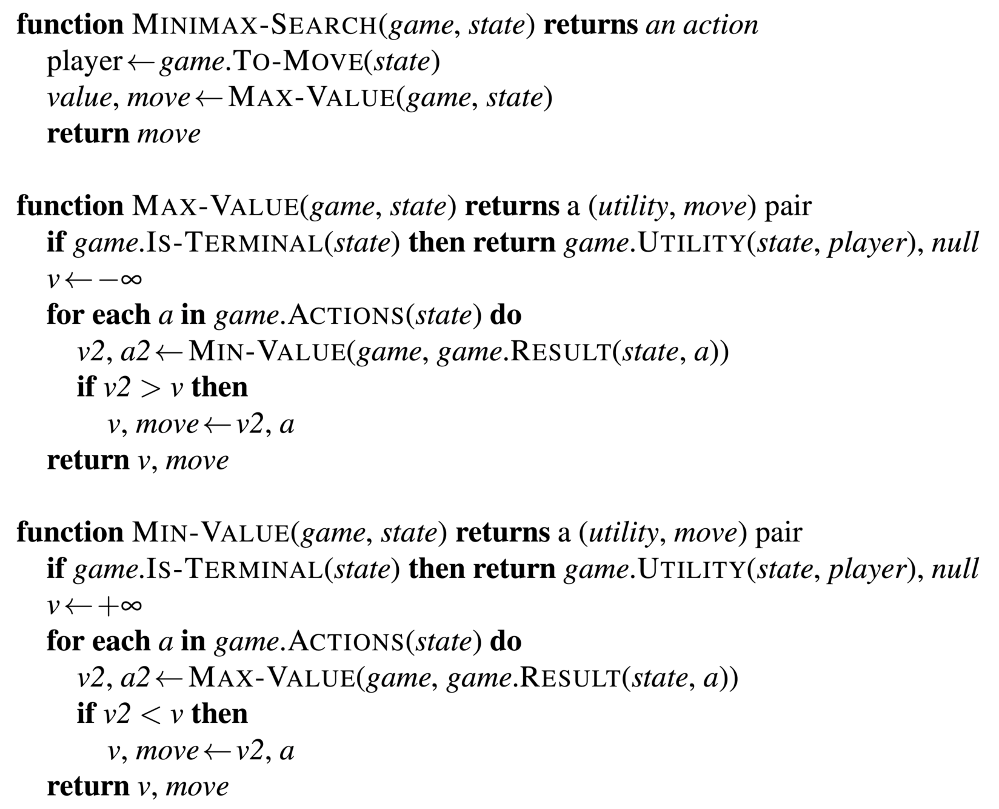

**Attribution**: (Russell and Norvig 2020, fig. 5.3)

## Walkthrough (first 4 minutes)

<https://youtu.be/l-hh51ncgDI>

**Attribution**: [Sebastian Lague](https://sebastian.itch.io)

Watch the first 5m 20s of the video.

The video introduces a variant of the **minimax** algorithm that
includes a **maximum depth parameter**, enabling the algorithm to
terminate at a user-specified depth. This approach is essential for
games with extensive search spaces, such as chess and Go. However, it
necessitates a reliable method for evaluating the current state,
referred to as static evaluation in the video.

## Base

In [11]:
# Base class for the game
class Game:
    def __init__(self):
        pass

    def get_valid_moves(self, state):
        pass

    def make_move(self, state, move, player):
        pass

    def is_terminal(self, state):
        pass

    def evaluate(self, state):
        pass

    def display(self, state):
        pass

    def get_opponent(self, player):
        pass

## Tic-Tac-Toe

In [12]:
# Tic-Tac-Toe game class
class TicTacToe(Game):

    def __init__(self):
        self.size = 3
        self.board = np.full((self.size, self.size), ' ')

    def get_valid_moves(self, state):
        # Returns a list of available positions
        moves = []
        for i in range(self.size):
            for j in range(self.size):
                if state[i][j] == ' ':
                    moves.append((i, j))
        return moves

    def make_move(self, state, move, player):
        # Returns a new state after making the move
        new_state = state.copy()
        new_state[move] = player
        return new_state

    def is_terminal(self, state):

        # Check rows, columns, and diagonals for a win
        lines = []
        lines.extend(state)  # Rows
        lines.extend(state.T)  # Columns
        lines.append(np.diagonal(state))  # Main diagonal
        lines.append(np.diagonal(np.fliplr(state)))  # Anti-diagonal

        for line in lines:
            if np.all(line == 'X') or np.all(line == 'O'):
                return True

        # Check for a draw (no empty spaces)
        if ' ' not in state:
            return True

        return False

    def evaluate(self, state):

        # Simple evaluation function
        lines = []
        lines.extend(state)  # Rows
        lines.extend(state.T)  # Columns
        lines.append(np.diagonal(state))  # Main diagonal
        lines.append(np.diagonal(np.fliplr(state)))  # Anti-diagonal

        for line in lines:
            if np.all(line == 'X'):
                return 1  # X wins
            if np.all(line == 'O'):
                return -1  # O wins

        return 0  # Draw or ongoing

    def display(self, state):

        display_tic_tac_toe(state, title=None)

    def get_opponent(self, player):
        return 'O' if player == 'X' else 'X'

## Minimax

In [13]:
import math

def minimax(game, state, depth, player, maximizing_player):

    if game.is_terminal(state) or depth == 0:
        return game.evaluate(state), None

    valid_moves = game.get_valid_moves(state)
    best_move = None

    if maximizing_player:
        max_eval = -math.inf
        for move in valid_moves:
            new_state = game.make_move(state, move, player)
            eval_score, _ = minimax(game, new_state, depth - 1, game.get_opponent(player), False)
            if eval_score > max_eval:
                max_eval = eval_score
                best_move = move
        return max_eval, best_move
    else:
        min_eval = math.inf
        for move in valid_moves:
            new_state = game.make_move(state, move, player)
            eval_score, _ = minimax(game, new_state, depth - 1, game.get_opponent(player), True)
            if eval_score < min_eval:
                min_eval = eval_score
                best_move = move
        return min_eval, best_move

## Run

In [14]:
def test_tic_tac_toe():

    game = TicTacToe()
    current_state = game.board.copy()
    player = 'X'
    maximizing_player=True

    # Simulate a game
    while not game.is_terminal(current_state):

        game.display(current_state)

        _, move = minimax(game, current_state, depth=9, player=player, maximizing_player=maximizing_player)

        if move is None:
            print("Game Over!")
            break

        current_state = game.make_move(current_state, move, player)

        player = game.get_opponent(player)
        maximizing_player = not maximizing_player

    game.display(current_state)
    result = game.evaluate(current_state)
    if result == 1:
        print("X wins!")
    elif result == -1:
        print("O wins!")
    else:
        print("It's a draw!")

## Run (1/2)

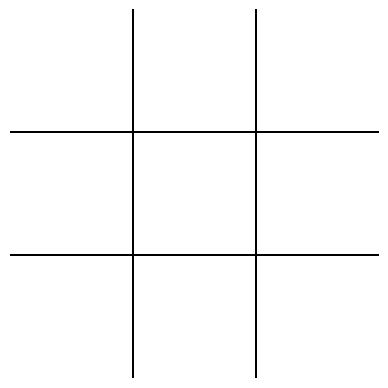

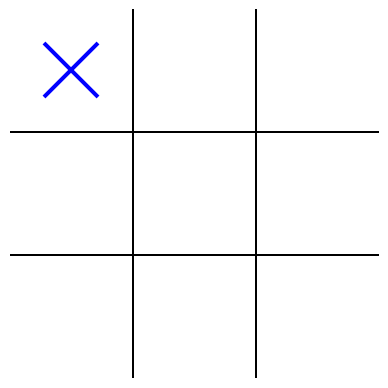

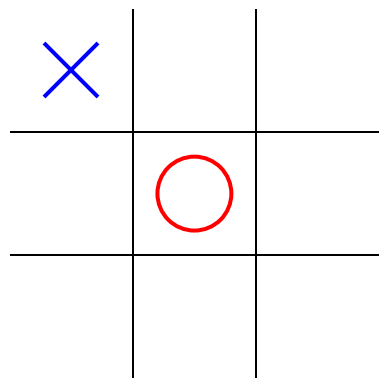

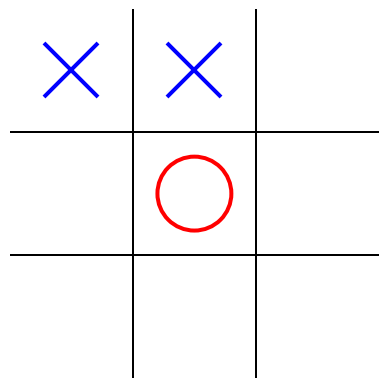

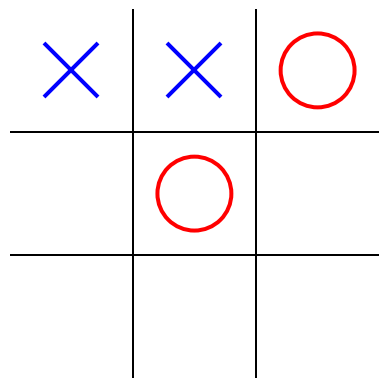

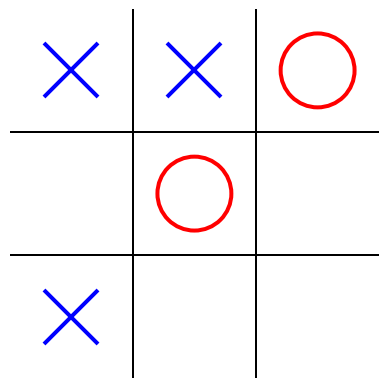

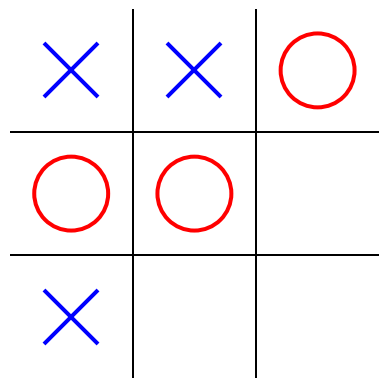

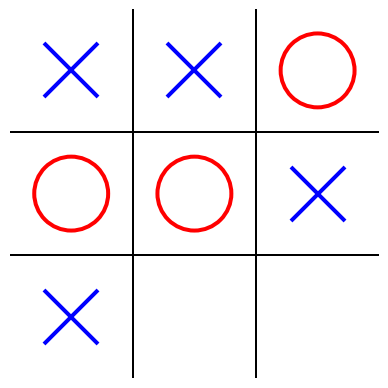

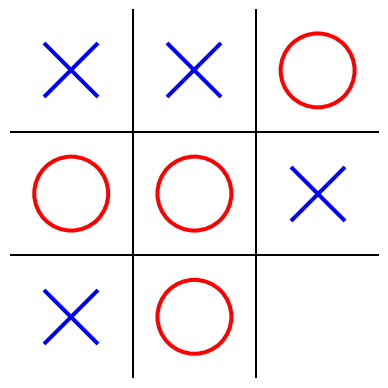

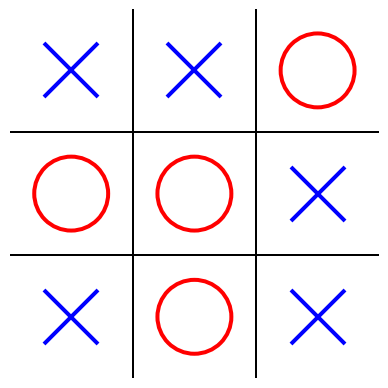

It's a draw!
Elapsed time: 24.218885 seconds

## Faster Execution (digression)

-   Is `test_tic_tac_toe` slower than expected?

-   Do you see an area for improvement?

## Caching

In [16]:
def memoize_minimax(f):

    cache = {}

    def wrapper(game, state, depth, player, maximizing_player):

        state_key = tuple(map(tuple, state)) # hashable state
        key = (state_key, depth, player, maximizing_player)

        if key in cache:
            return cache[key]

        result = f(game, state, depth, player, maximizing_player)
        cache[key] = result

        return result

    return wrapper

## Caching

In [17]:
@memoize_minimax
def minimax(game, state, depth, player, maximizing_player):

    # The minimax code remains the same, without any cache handling
    if game.is_terminal(state) or depth == 0:
        return game.evaluate(state), None

    valid_moves = game.get_valid_moves(state)
    best_move = None

    if maximizing_player:
        max_eval = -math.inf
        for move in valid_moves:
            new_state = game.make_move(state, move, player)
            eval_score, _ = minimax(game, new_state, depth - 1, game.get_opponent(player), False)
            if eval_score > max_eval:
                max_eval = eval_score
                best_move = move
        return max_eval, best_move
    else:
        min_eval = math.inf
        for move in valid_moves:
            new_state = game.make_move(state, move, player)
            eval_score, _ = minimax(game, new_state, depth - 1, game.get_opponent(player), True)
            if eval_score < min_eval:
                min_eval = eval_score
                best_move = move
        return min_eval, best_move

## Run (2/2)

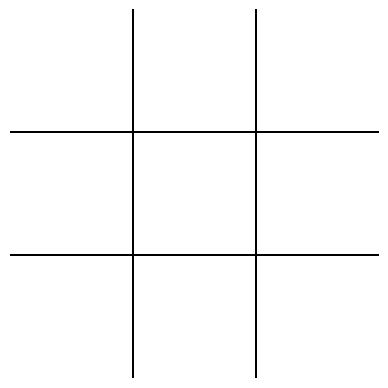

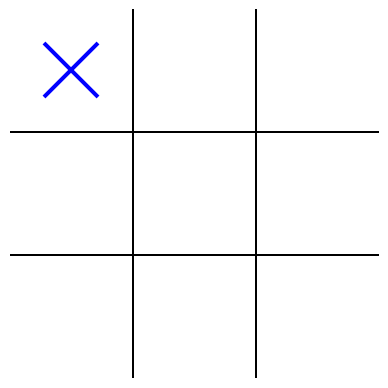

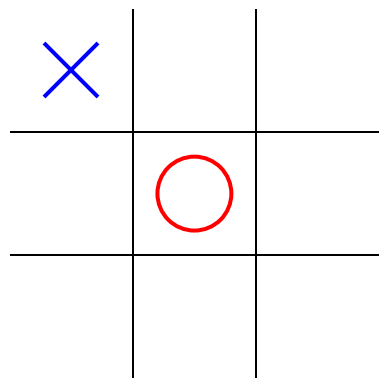

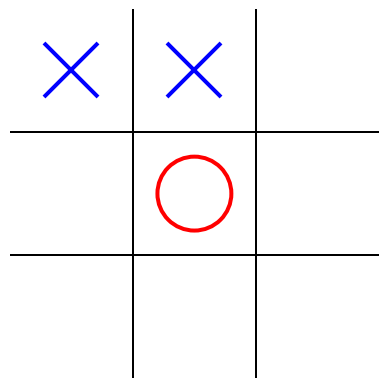

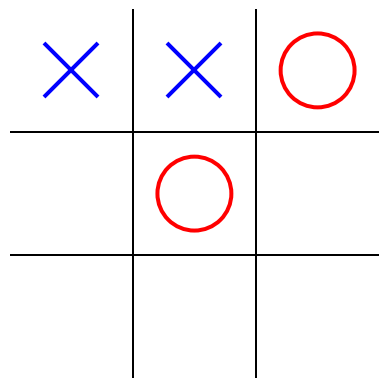

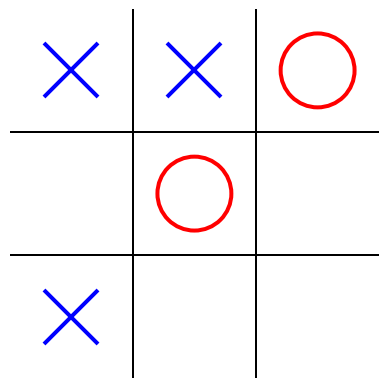

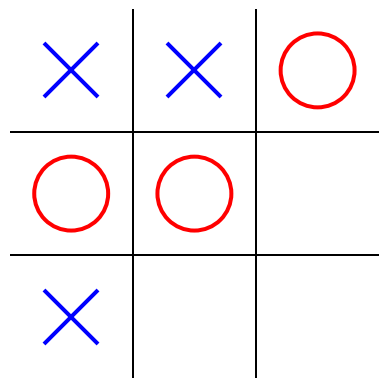

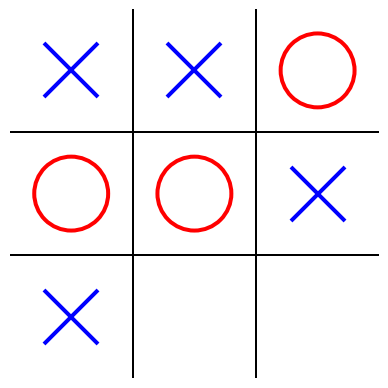

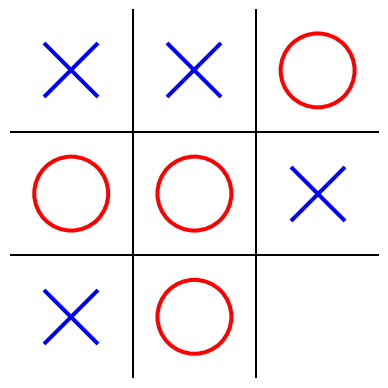

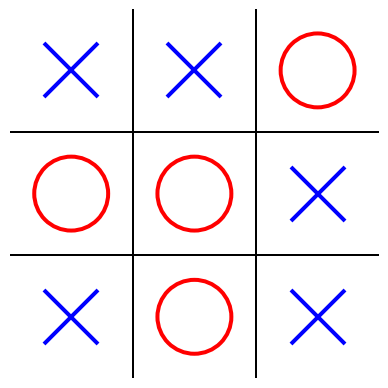

It's a draw!
Elapsed time: 0.515628 seconds

## Lower Predictability (digression)

In [19]:
import random

class TicTacToe(Game):

    def get_valid_moves(self, state):
        # Returns a list of available positions
        moves = []
        for i in range(self.size):
            for j in range(self.size):
                if state[i][j] == ' ':
                    moves.append((i, j))

        return random.shuffle(moves)

    # All the other methods stay the same

Games can become monotonous if you quickly discern patterns in your
opponent’s strategy, such as consistently choosing moves in a specific
sequence.

We are randomizing the order of moves prior to returning them. However,
the optimal move for a given configuration will remain fixed, if
solutions are cached.

## Exploration

-   Compare the reduction in execution time achieved through **symmetry
    considerations** versus **caching techniques**. Evaluate the
    **combined effect of both approaches**.

-   Develop a **[Connect
    Four](https://en.wikipedia.org/wiki/Connect_Four)** game
    implementation employing a **minimax search algorithm**.

-   Connect Four is **symmetric across its vertical axis**. Develop a
    new implementation that leverages this symmetry.

**See also**: [Connect 4: Principles and
Techniques](https://web.stanford.edu/class/archive/cs/cs221/cs221.1192/2018/restricted/posters/yuex/poster.pdf)

## Remark

The **number of valid sequences of actions grows factorially**, with
particularly large growth observed in games like chess and Go.

## Pruning

To enhance the efficiency of the minimax algorithm, one could possibly
**prune** certain parts of the search tree, thereby **avoiding the
exploration of descendant nodes**.

## Pruning

**How** would you implement this modification? **What** factors would
you take into account?

## Pruning

Tree pruning should be performed **only when it can be demonstrated that
those subtrees cannot yield better solutions**.

But **how**?

## Criteria for Pruning

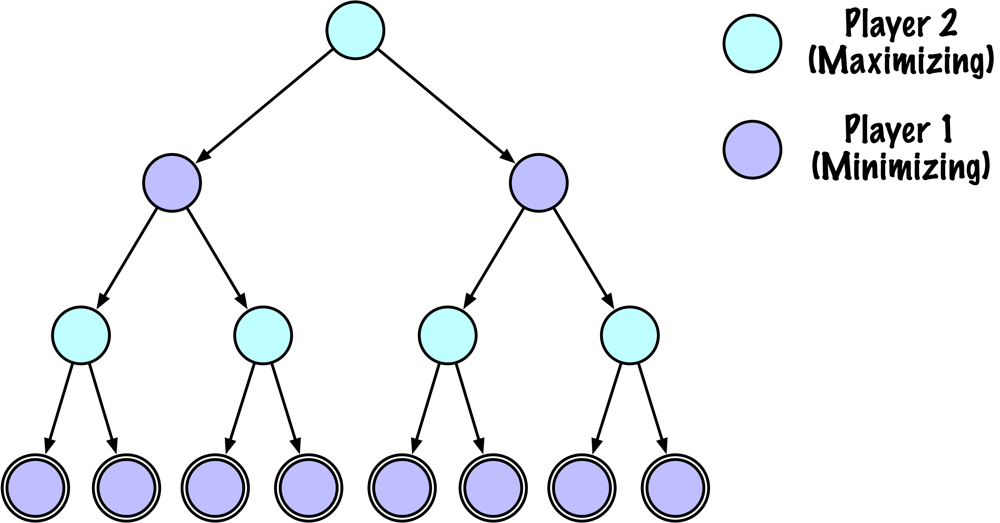

Based on [Algorithms Explained – minimax and alpha-beta
pruning](https://youtu.be/l-hh51ncgDI) by Sebastian Lague.

## Criteria for Pruning

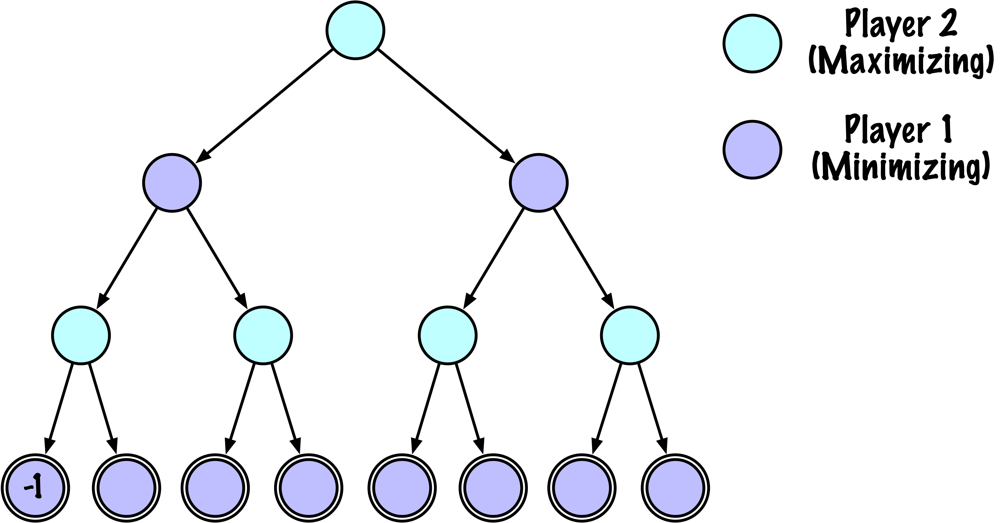

## Criteria for Pruning

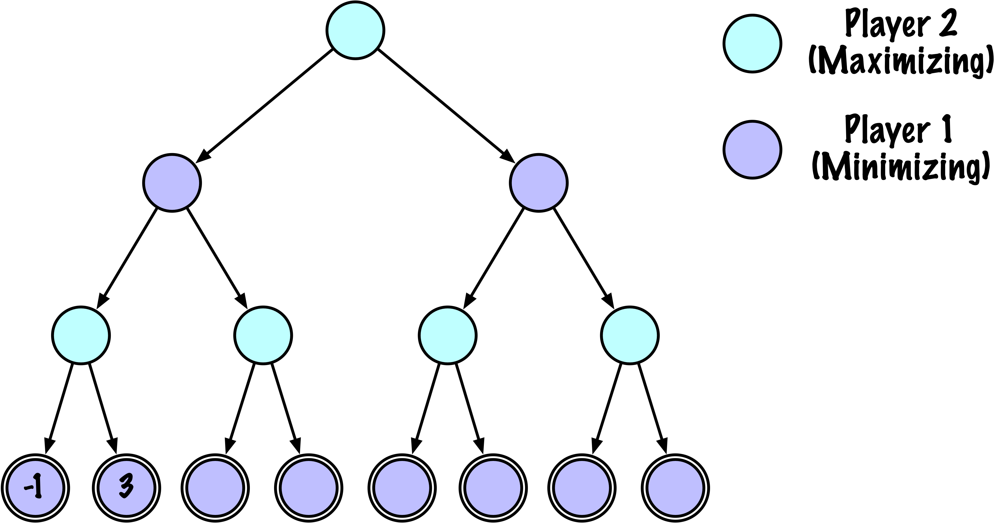

## Criteria for Pruning

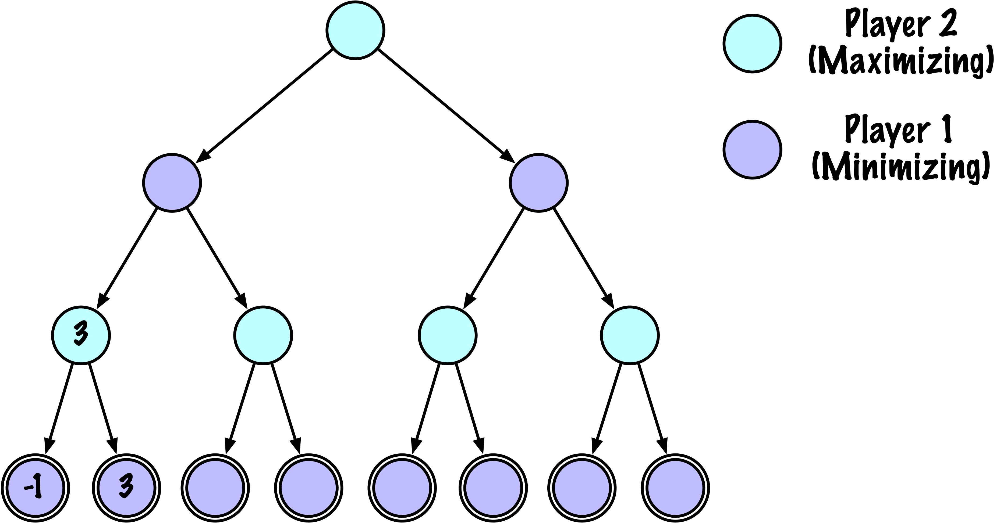

## Criteria for Pruning

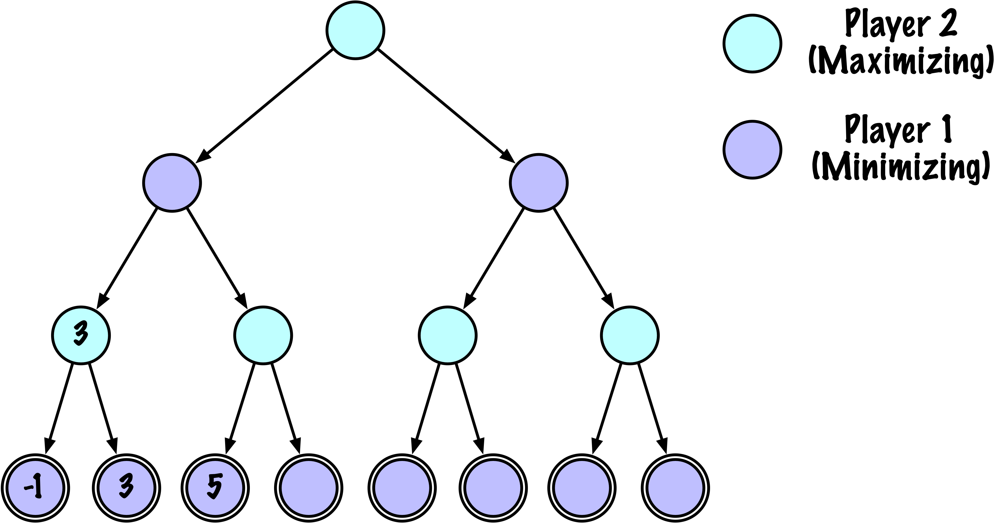

## Criteria for Pruning

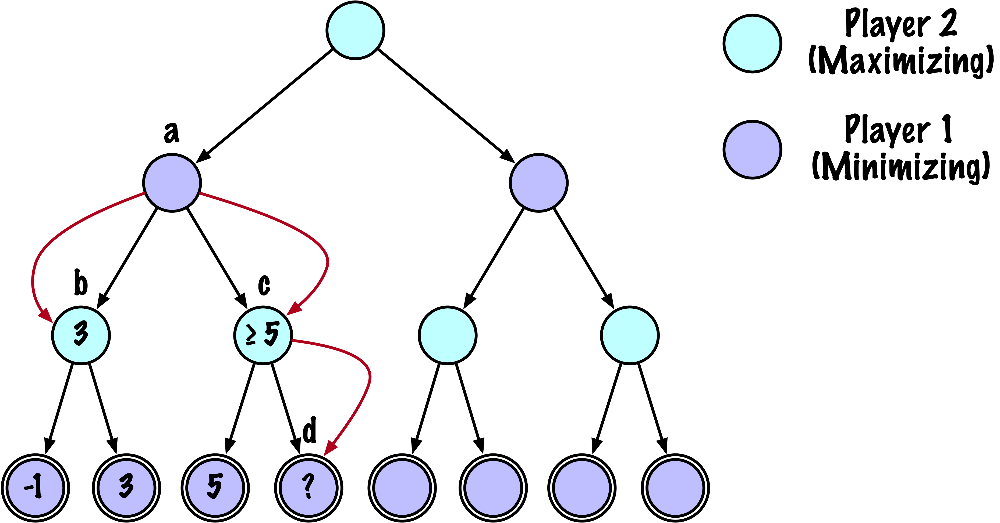

We know that the value of node **c** is at least 5, since **c** is a
maximizing node.

Node **a** is minimizing node and has to choose between 3 (node **b**)
and at least 5 (node **c**). No matter what we find in node **d** does
not matter, node **a** will choose 3.

## Criteria for Pruning

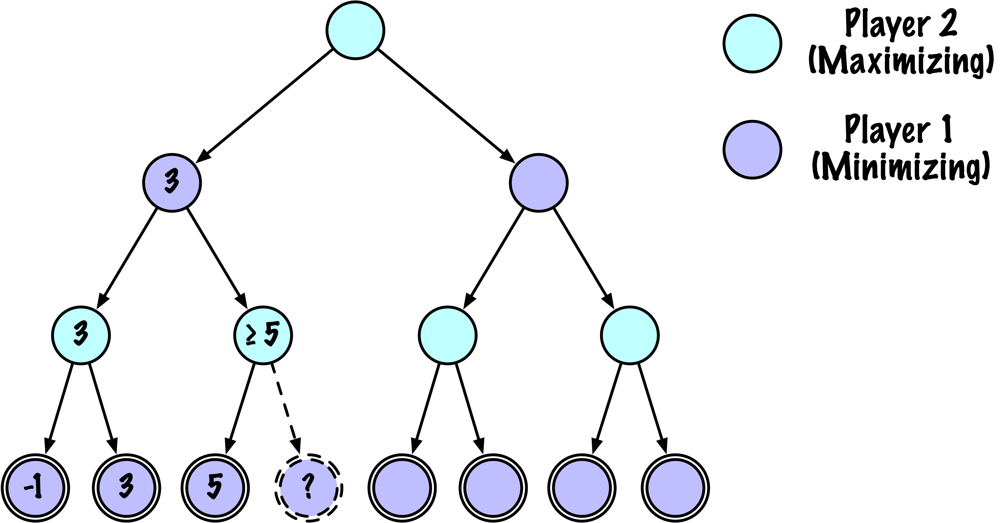

Let us continue briefly.

## Criteria for Pruning

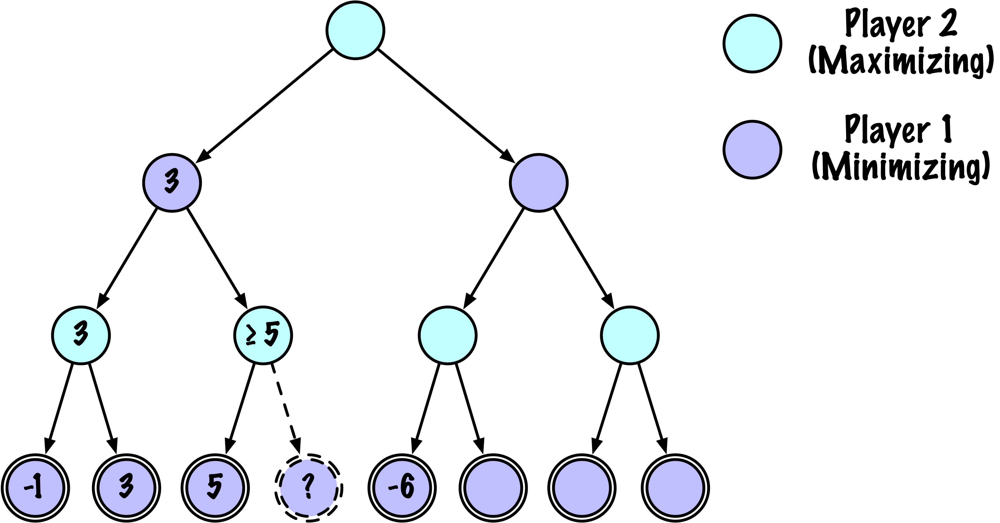

Let us continue briefly.

## Criteria for Pruning

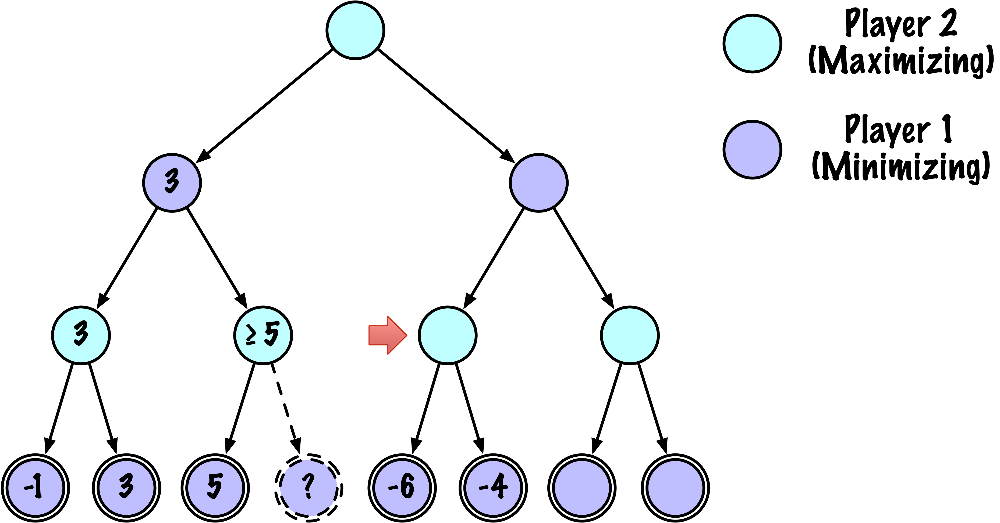

What value should be assigned to the node indicated by the arrow?

This is a maximizing node; therefore, we will assign it the value of -4.

## Criteria for Pruning

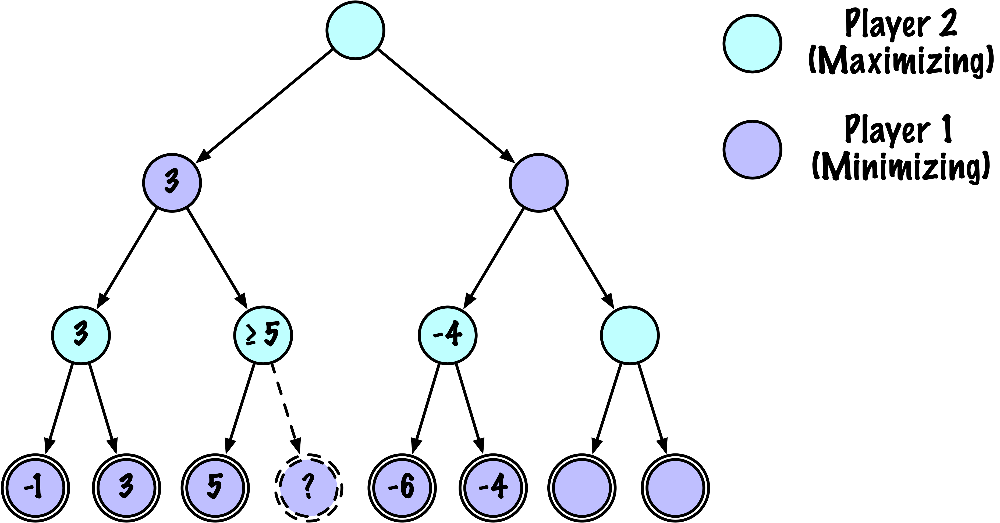

## Criteria for Pruning

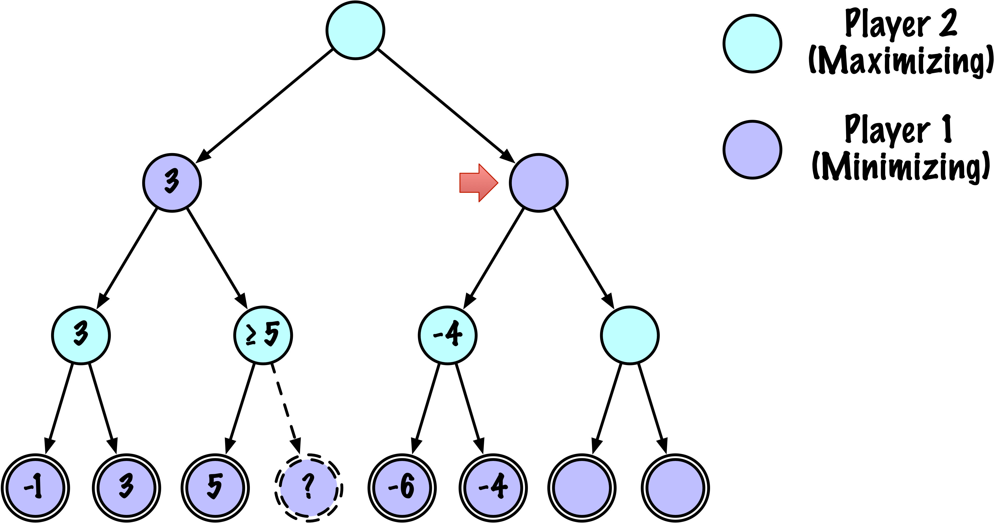

The node marked by an arrow presents an interesting scenario.

Can you work out its value?

## Criteria for Pruning

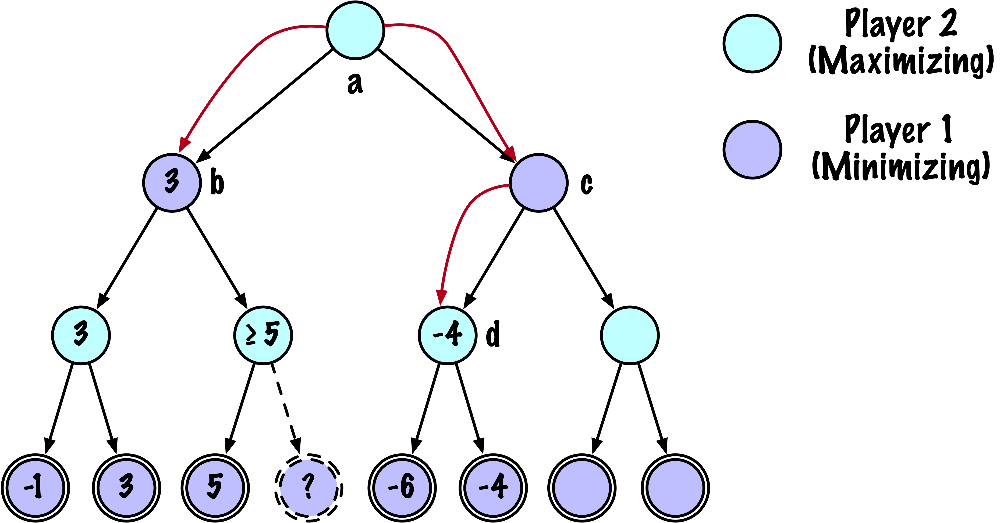

What do we know?

## Criteria for Pruning

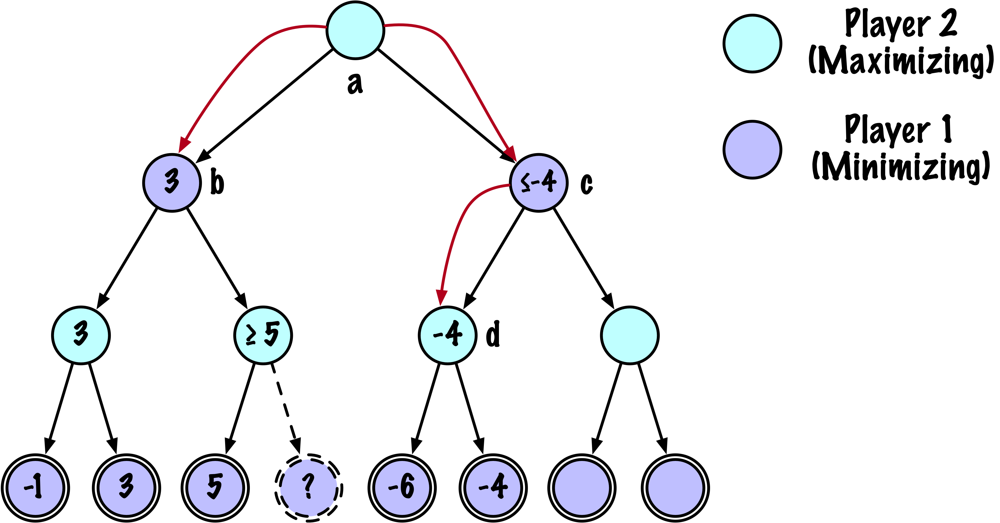

Can I say that the maximum value for node **c** is -4?

Suppose the right child of node **c** contains the value 5. Would you
assign 5 to node **c**? Certainly not. As a minimizing node, node **c**
will have a value no greater than -4.

## Criteria for Pruning

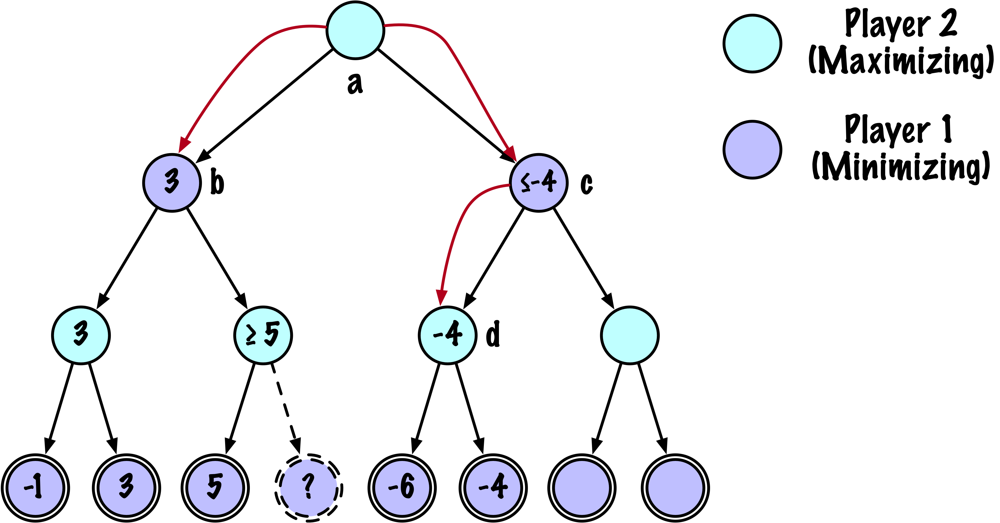

Exploring the right child of node **c** might reveal a value lower than
-4. **Does this matter?**

## Criteria for Pruning

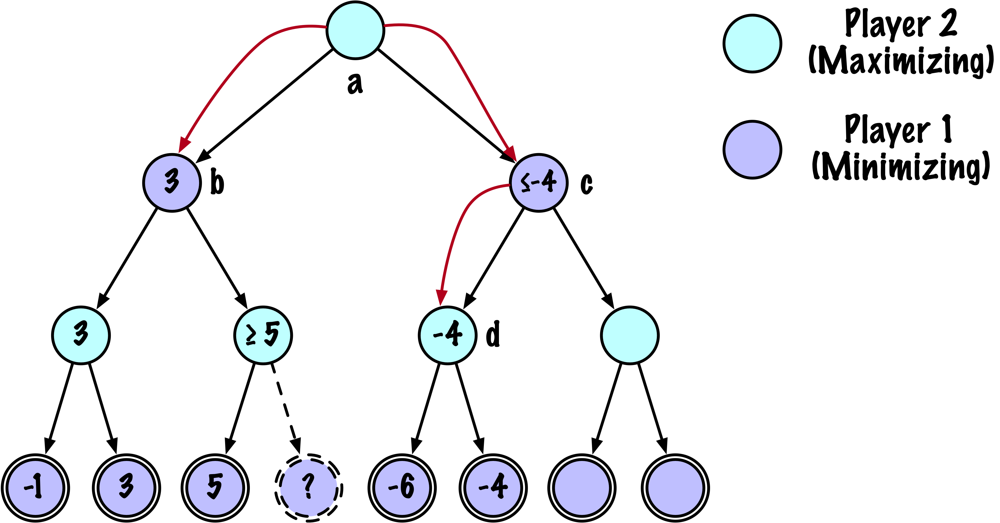

Node **a** is a maximizing node. From node **b**, it ascertains a
minimum achievable value of 3.

Node **c** is a minimizing node. From node **d**, it determines that the
maximum value it can return is -4.

Consequently, node **a** will always select node **b**, regardless of
the value stored in node **c**, since the value of **c** will not exceed
-4.

Even if node **c**, as a minimizing node, discovers an extremely low
value (e.g., -100) by exploring its right child, node **a**, being a
maximizing node, will still opt for node **b**.

## Criteria for Pruning

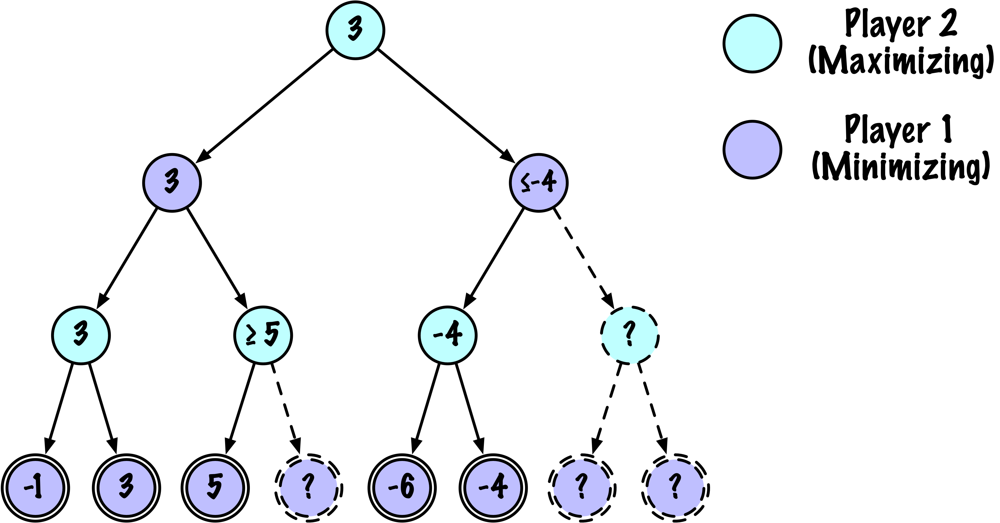

The decisions made by players 1 and 2 remain unchanged with or without
pruning. However, pruning reduces the number of nodes visited.

## Alph-Beta Pruning

**Alpha-beta pruning** is an optimization technique for the minimax
algorithm that **reduces the number of nodes evaluated** in the search
tree.

## Alph-Beta Pruning

It achieves this by **eliminating branches that cannot possibly
influence the final decision**, using two parameters:

-   **alpha**, the maximum score that the maximizing player is assured,
    and

-   **beta**, the minimum score that the minimizing player is assured.

## Maximizing Player’s Perspective

At a **maximizing node**:

-   The **maximizer** aims to **maximize** the score.

-   **Alpha ($\alpha$)** is updated to the **highest** value found so
    far among child nodes.

-   **Process**:

    -   Initialize $\alpha = -\infty$.

    -   For each child node:

        -   Compute the evaluation score.

        -   Update $\alpha = \max(\alpha, \mathrm{child\_score})$.

## Minimizing Player’s Perspective

At a **minimizing node**:

-   The **minimizer** aims to **minimize** the score.

-   **Beta ($\beta$)** is updated to the **lowest** value found so far
    among child nodes.

-   **Process**:

    -   Initialize $\beta = \infty$.

    -   For each child node:

        -   Compute the evaluation score.

        -   Update $\beta = \min(\beta, \mathrm{child\_score})$.

## Alph-Beta Pruning

When a node’s evaluation proves it **cannot improve** on the current
alpha or beta, further **exploration of that branch is halted**, thereby
enhancing computational efficiency without affecting the outcome.

## Role of Alpha and Beta in Pruning

**Pruning Condition**:

-   **If $\beta \leq \alpha$**, further exploration of the current
    node’s siblings is unnecessary.

-   **Rationale**:

    -   The maximizer has a guaranteed score of at least $\alpha$.

    -   The minimizer can ensure that the maximizer cannot get a better
        score than $\beta$.

    -   If $\beta \leq \alpha$, the maximizer won’t find a better option
        in this branch.

## Alpha-Beta Search

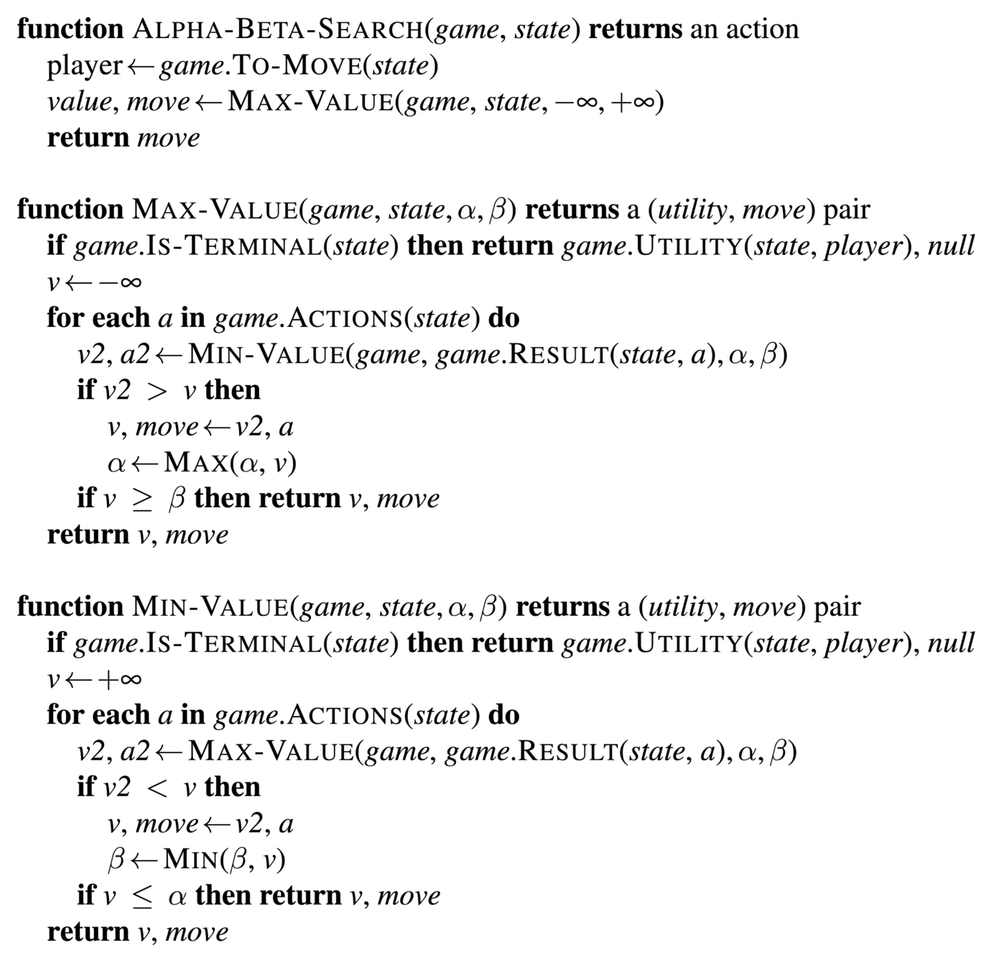

**Attribution**: (Russell and Norvig 2020, fig. 5.7)

## Walkthrough (6:21 to 8:10)

<https://youtu.be/l-hh51ncgDI>

**Attribution**: [Sebastian Lague](https://sebastian.itch.io). Start
watching at 6**m** 21**s**.

## Node Order

-   The **effectiveness of pruning** is influenced by the **order** in
    which nodes are evaluated.

-   Greater pruning is achieved if nodes are ordered from **most to
    least promising**.

**Refer to**: Shannon (1959) for a discussion within the context of
chess.

## Alpha-Beta Search

In [20]:
# Minimax algorithm with Alpha-Beta Pruning

def alpha_beta_search(game, state, depth, player, alpha, beta, maximizing_player):

    """
    Minimax algorithm with alpha-beta pruning.

    :param game: The game instance.
    :param state: The current game state.
    :param depth: The maximum depth to search.
    :param player: The current player ('X' or 'O').
    :param alpha: The best value that the maximizer currently can guarantee at that level or above.
    :param beta: The best value that the minimizer currently can guarantee at that level or above.
    :param maximizing_player: True if the current move is for the maximizer.
    :return: A tuple of (evaluation score, best move).
    """

## Alpha-Beta Search

In [21]:
    # Base case: check for terminal state or maximum depth

    if game.is_terminal(state) or depth == 0:
        score = game.evaluate(state)
        return score, None  # Return the evaluation score and no move

    valid_moves = game.get_valid_moves(state)
    best_move = None  # Initialize the best move

The base case is identical to that of the `minimax` algorithm.

## Alpha-Beta Search

In [22]:
    if maximizing_player:

        max_eval = -math.inf  # Initialize maximum evaluation

        for move in valid_moves:

            # Simulate the move
            new_state = game.make_move(state, move, player)

            # Recursive call to alpha_beta_search for the minimizing player
            eval_score, _ = alpha_beta_search(game, new_state, depth - 1, game.get_opponent(player), alpha, beta, False)

            if eval_score > max_eval:
                max_eval = eval_score  # Update maximum evaluation
                best_move = move       # Update best move

            alpha = max(alpha, eval_score)  # Update alpha

            if beta <= alpha:
                break  # Beta cut-off (prune the remaining branches)

        return max_eval, best_move

## Alpha-Beta Search

In [23]:
    else:

        min_eval = math.inf  # Initialize minimum evaluation

        for move in valid_moves:

            # Simulate the move
            new_state = game.make_move(state, move, player)

            # Recursive call to alpha_beta_search for the maximizing player
            eval_score, _ = alpha_beta_search(game, new_state, depth - 1, game.get_opponent(player), alpha, beta, True)

            if eval_score < min_eval:
                min_eval = eval_score  # Update minimum evaluation
                best_move = move       # Update best move

            beta = min(beta, eval_score)  # Update beta

            if beta <= alpha:
                break  # Alpha cut-off (prune the remaining branches)

        return min_eval, best_move

## Walkthrough

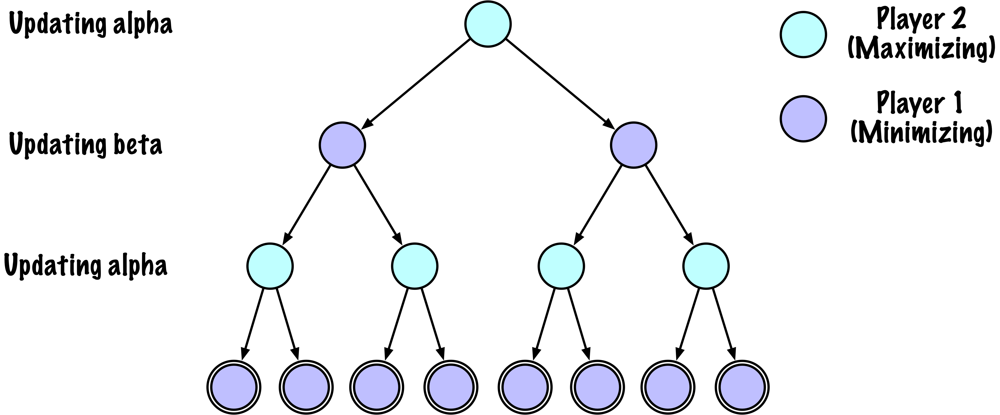

**Maximizing** nodes update the **alpha** values, while **minimizing**
nodes update the **beta** values.

## Walkthrough

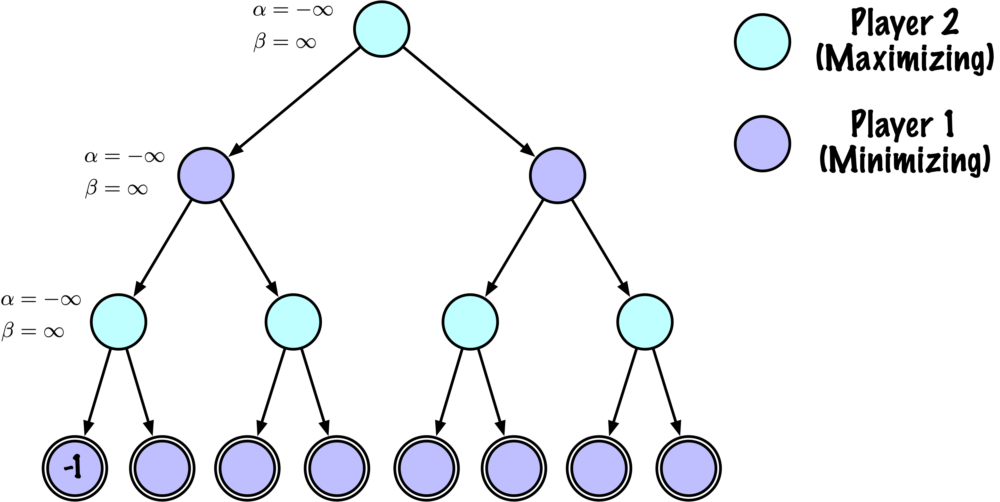

The values of $\alpha$ and $\beta$ are initially set to $-\infty$ and
$\infty$, respectively. The recursive calls continue traversing the tree
until the leftmost node is reached.

## Walkthrough

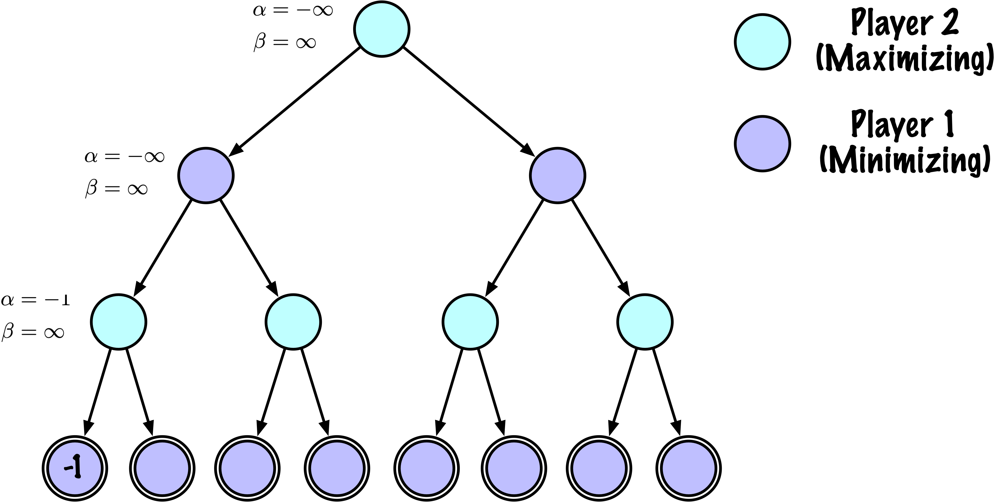

The value of $\alpha$ is updated to -1.

## Walkthrough

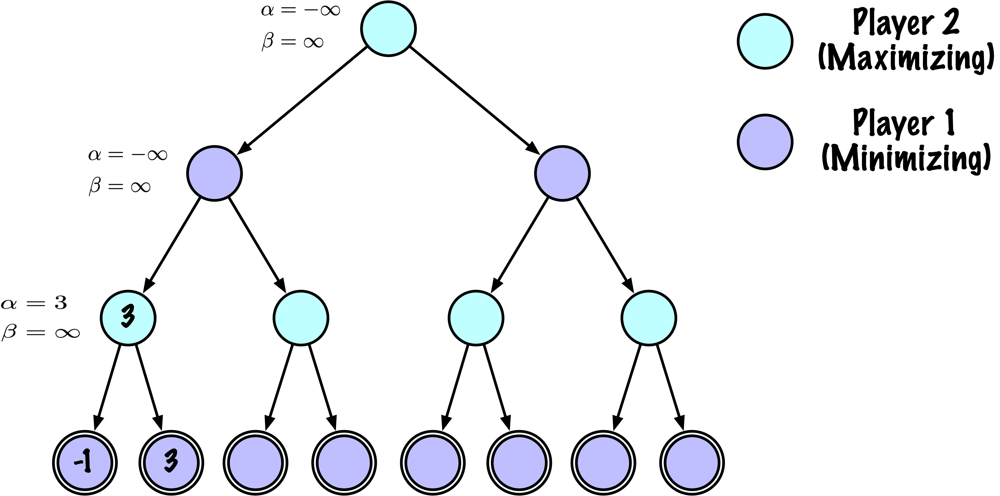

Updating $\alpha$ to 3.

## Walkthrough

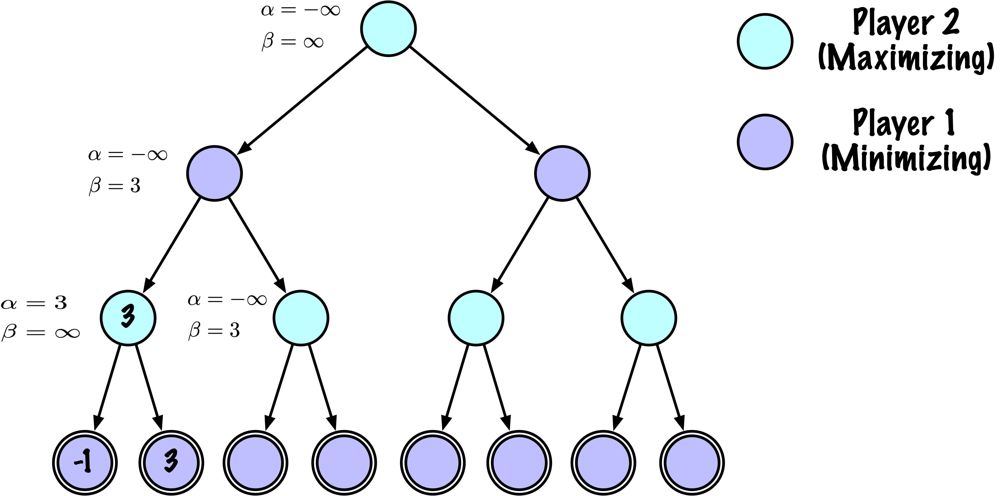

Updating $\beta$ from $\infty$ to 3. Passing those values to the right
child.

## Walkthrough

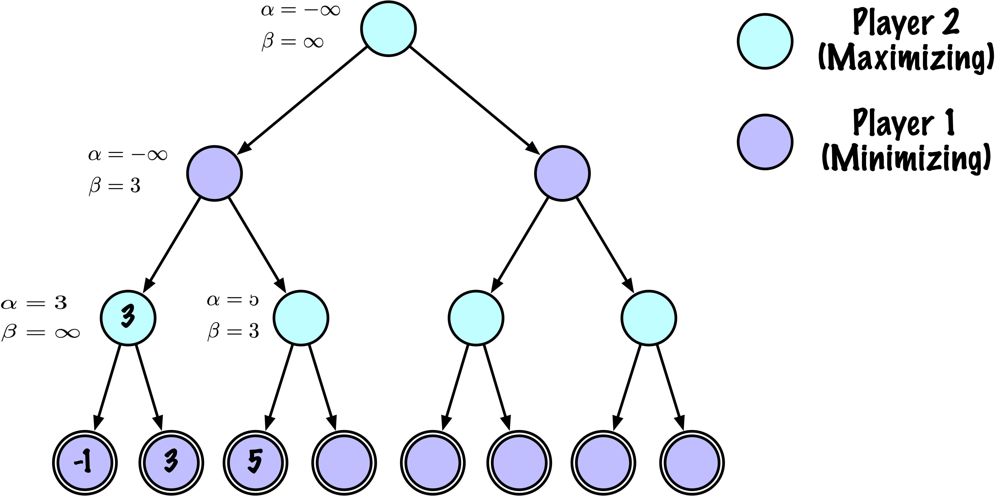

Updating $\alpha$ from $-\infty$ to 5. We now have $\beta \le \alpha$.

## Walkthrough

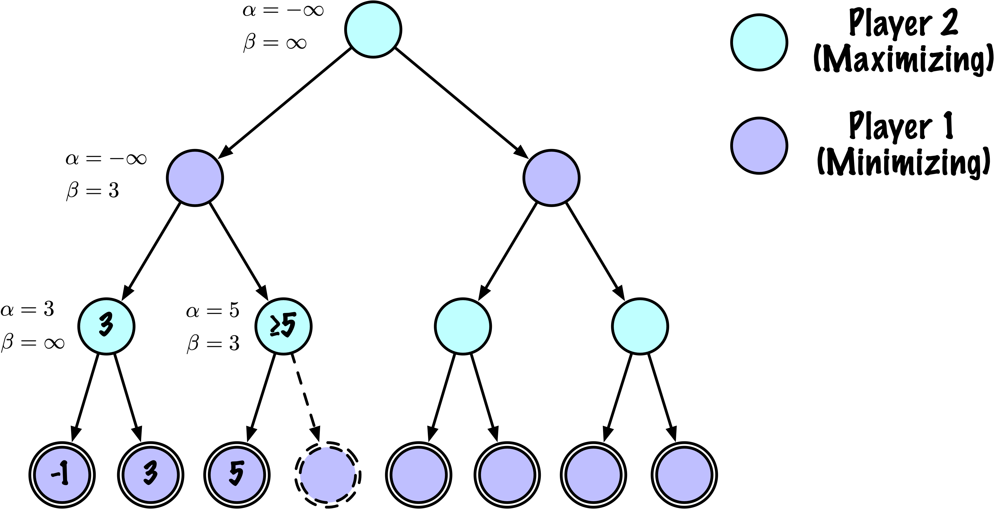

The right child is not visited. The parent (a minimizer) has a better
option ($\beta$) than $\alpha$.

## Walkthrough

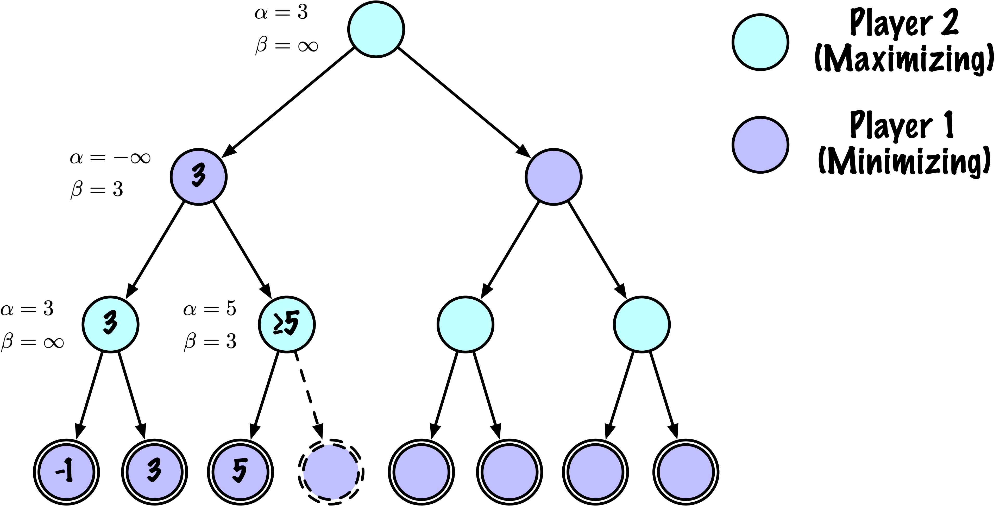

Returning from the recursive calls, the root node receives a value of 3
from its left child and updates its $\alpha$ to 3, which exceeds its
initial value of $-\infty$.

## Walkthrough

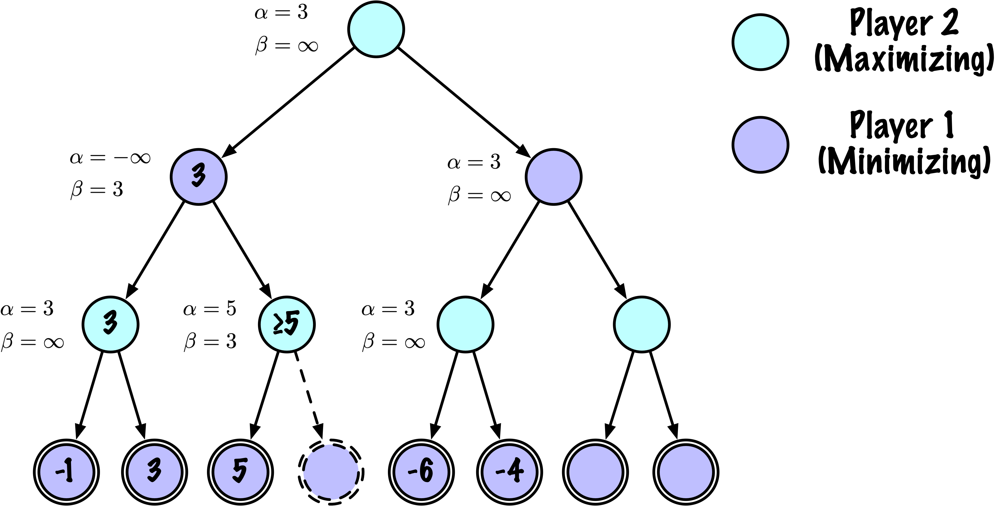

Now traversing the right subtree from the root. Upon reaching left-most
maximizing node of the right subtree, $\alpha$ is not updated since -6
and -4 are less than 3.

## Walkthrough

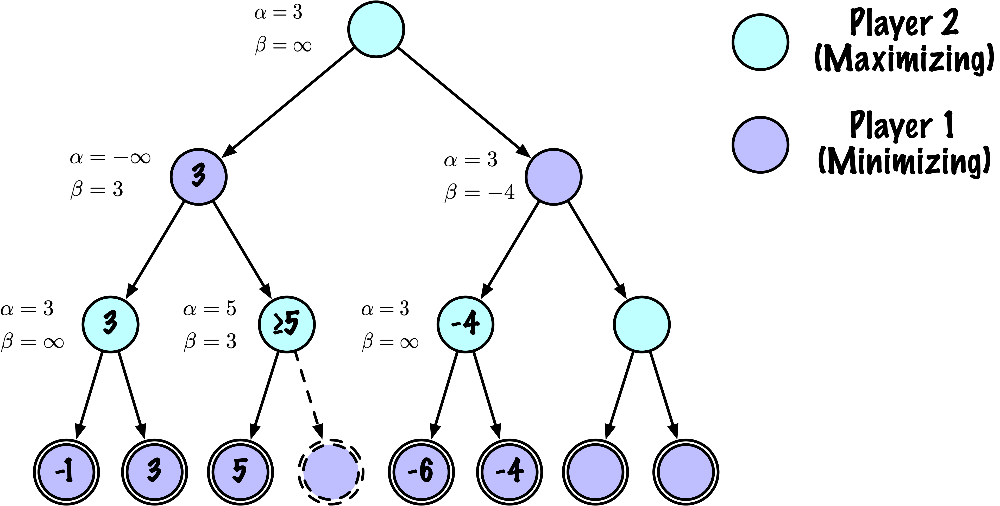

$\beta$ is now updated to -4. We now have that $\beta \le \alpha$.

## Walkthrough

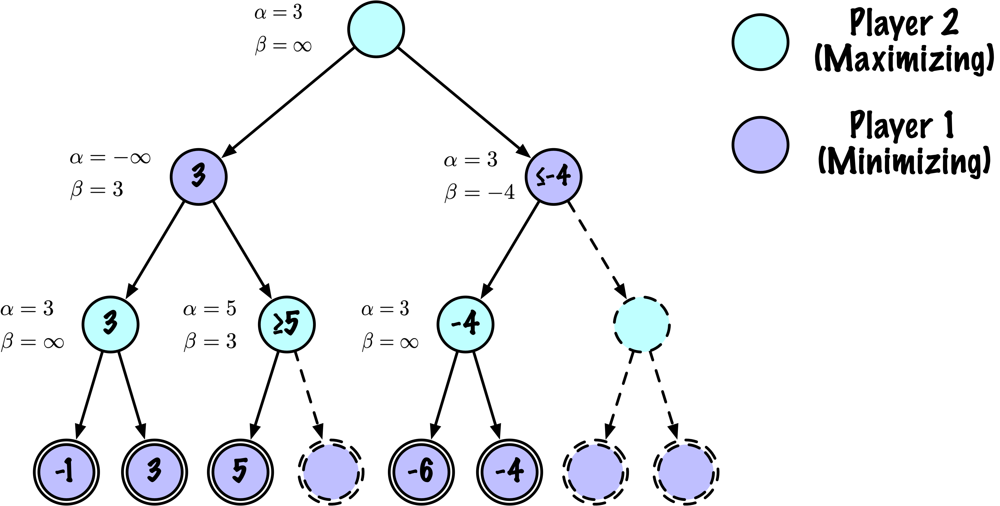

The right child is pruned.

## Walkthrough

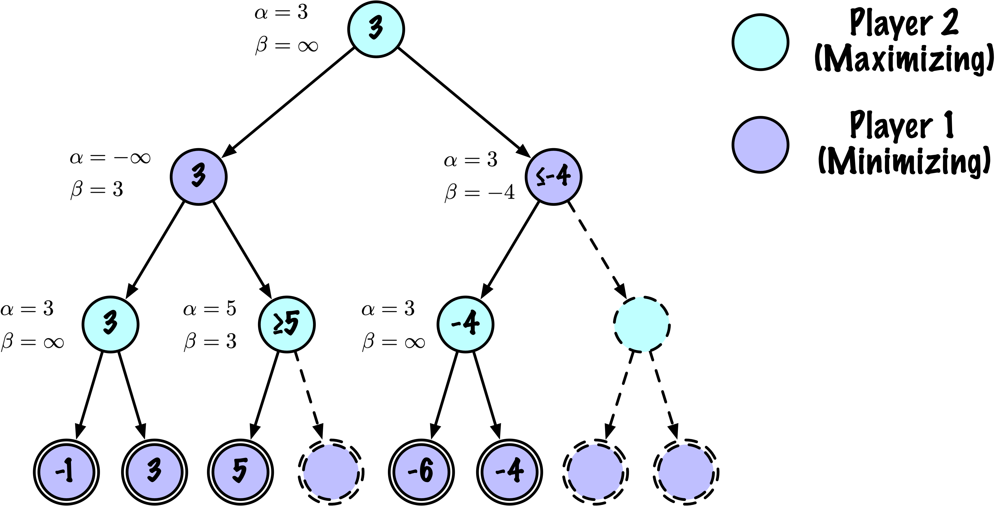

The maximizing player knows that its best move has a value of 3 (going
left).

## Summmary

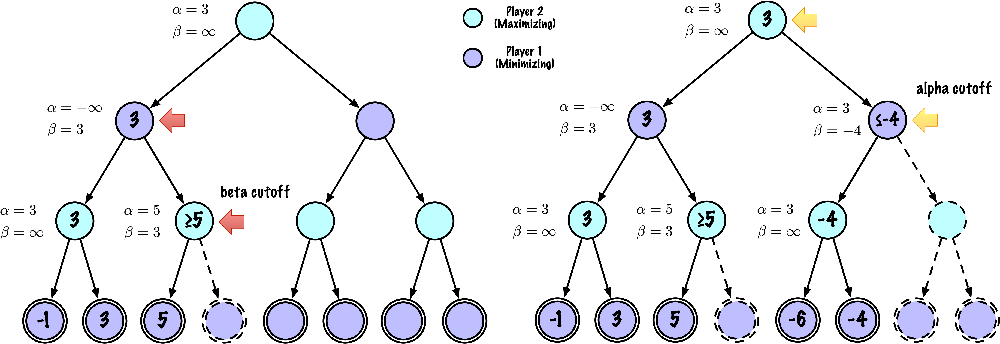

-   **Alpha Cutoff:** Occurs at **minimizer nodes** when
    $\beta \le \alpha$.
-   **Beta Cutoff:** Occurs at **maximizer nodes** when
    $\alpha \ge \alpha$.

1.  **Pruning at Both Node Types:**
    -   Pruning can occur during both the minimization and maximization
        phases. This means that both **minimizer** and **maximizer**
        nodes can be pruned if certain conditions are met.
2.  **Updating Alpha and Beta:**
    -   At **maximizer nodes**, the algorithm updates the **alpha**
        value to the maximum of its current value and the value of the
        child nodes evaluated so far.
    -   At **minimizer nodes**, the algorithm updates the **beta** value
        to the minimum of its current value and the value of the child
        nodes evaluated so far.
3.  **Pruning Conditions:**
    -   **At Maximizer Nodes:**
        -   If **alpha** becomes **greater than or equal to beta**
            ($\alpha \ge \alpha$), further exploration of the current
            node’s descendants can be stopped. This is because the
            minimizer (opponent) can force the outcome to be no better
            than beta, so the maximizer cannot improve the result beyond
            this point.
        -   This is often referred to as a **beta cutoff** because the
            value of beta is causing the pruning at a maximizer node.
    -   **At Minimizer Nodes:**
        -   If **beta** becomes **less than or equal to alpha**
            ($\beta \le \alpha$), the algorithm can prune the remaining
            child nodes of the minimizer node. This is because the
            maximizer can force a result of at least alpha, so the
            minimizer cannot find a better (lower) outcome.
        -   This is known as an **alpha cutoff** because the value of
            alpha is causing the pruning at a minimizer node.
4.  **Process of Pruning:**
    -   The pruning occurs **not when alpha or beta are updated**, but
        when the pruning condition (`α ≥ β` at maximizer nodes or
        `β ≤ α` at minimizer nodes) is met.
    -   Once these conditions are satisfied, the algorithm knows that
        further exploration will not yield a better outcome, and thus it
        can safely prune those branches.

**Summary:**

-   **Alpha Cutoff:** Occurs at **minimizer nodes** when
    $\beta \le \alpha$.

-   **Beta Cutoff:** Occurs at **maximizer nodes** when
    $\alpha \ge \alpha$.

-   **Why Pruning Occurs:**

    -   In both cases, the pruning occurs because further exploration
        cannot influence the final decision. The opponent can force the
        game into a situation that’s no better than the current
        evaluation.

-   **Impact on Algorithm Efficiency:**

    -   By implementing these cutoffs, the alpha-beta pruning algorithm
        reduces the number of nodes that need to be evaluated compared
        to the standard minimax algorithm, thus improving efficiency
        without affecting the outcome.

## Minimax vs. Alpha-Beta Pruning

-   Grasping **why alpha-beta pruning boosts minimax efficiency**
    without altering outcomes requires **careful thought**.

-   The algorithm **changes are minimal**.

-   Is the enhancement **justified**?

## Minimax vs. Alpha-Beta Pruning

Number of nodes explored by the Minimax Search algorithm: 255,168

Number of nodes explored by the Alpha-Beta Search algorithm: 7,330

A 97.13% reduction in the number of the nodes visited!

## Exploration

Implement a **[Connect
Four](https://en.wikipedia.org/wiki/Connect_Four)** game using the
**Alpha-Beta Search algorithm**. Conduct a comparative analysis between
the Minimax and Alpha-Beta Search implementations.

# Prologue

## Further exploration

-   **Expetimax** search: handling players that are not perfect;
-   **Expectiminimax**: handling chance in games such as backgammon.

## Summary

-   Introduction to adversarial search
-   Zero-sum games
-   Introduction to the minimax search method
-   Role of alpha and beta pruning in minimax search

-   **Introduction to Adversarial Search:**
    -   Exploration of competitive environments with conflicting
        objectives.
-   **Classification of Games:**
    -   Types based on determinism (deterministic vs. stochastic).
    -   Number of players (one, two, or more).
    -   Nature of competition (zero-sum vs. non-zero-sum).
    -   Availability of information (perfect vs. imperfect information).
-   **Zero-Sum Games:**
    -   Definition and characteristics.
    -   Example: Tic-Tac-Toe as a zero-sum game.
-   **Deterministic Games Framework:**
    -   Components: states, players, actions, transition functions,
        final states, rewards.
    -   Development of policies from initial to final states.
-   **Game Strategies and Complexity:**
    -   Analysis of never-lose strategies in Tic-Tac-Toe.
    -   Discussion on the impact of move order (first or second player).
    -   Exploration of game complexity in Tic-Tac-Toe, Chess, and Go.
-   **Optimal Play and Perfect Information:**
    -   Concepts of optimal strategies and their implications.
    -   Importance of perfect information in game theory.
-   **Minimax Algorithm:**
    -   Introduction to the minimax search method.
    -   Application in determining optimal moves in adversarial games.
    -   Implementation details with a Python example for Tic-Tac-Toe.
-   **Efficiency Improvements:**
    -   Use of caching (memoization) to enhance algorithm performance.
    -   Reduction of computational overhead in game search trees.
-   **Pruning Techniques:**
    -   Introduction to pruning in search trees to avoid unnecessary
        computations.
    -   Detailed explanation of Alpha-Beta pruning.
    -   Criteria for pruning and walkthrough examples illustrating the
        process.
-   **Alpha-Beta Pruning:**
    -   Integration with the minimax algorithm.
    -   Role of alpha and beta parameters in optimizing search.
    -   Impact on the number of nodes evaluated.
-   **Performance Comparison:**
    -   Analysis of node exploration between minimax and alpha-beta
        pruning.
    -   Quantitative demonstration of efficiency gains.
-   **Node Ordering and Pruning Effectiveness:**
    -   Discussion on how node evaluation order affects pruning success.
    -   Strategies for ordering nodes to maximize pruning potential.

## Next lecture

-   We will look at the Monte Carlo Tree Search (MCTS) algorithm

## References

Russell, Stuart, and Peter Norvig. 2020. *Artificial Intelligence: A
Modern Approach*. 4th ed. Pearson. <http://aima.cs.berkeley.edu/>.

Shannon, Claude E. 1959. “Programming a Computer Playing Chess.”
*Philosophical Magazine* Ser.7, 41 (312).

------------------------------------------------------------------------

Marcel **Turcotte**

<Marcel.Turcotte@uOttawa.ca>

School of Electrical Engineering and **Computer Science** (EE**CS**)

University of Ottawa